In [1]:
import torch
torch.__version__

'2.0.1'

In [2]:
torch.cuda.get_device_name(0)

'NVIDIA GeForce RTX 3050 Ti Laptop GPU'

In [3]:
torch.cuda.empty_cache()

## Initilizing The Trainer.
 The trainer is in charge of training, evaluation, saving checkpoints, etc.

### There's two important arguments to the trainer:

1) `ckpt_root_dir` - this is the directory where results from all your experiments will be saved.
   
2) `experiment_name` - all checkpoints, logs, and tensorboards will be saved in a directory with the name you specify here.

In [3]:
from super_gradients.training import Trainer

CHECKPOINT_DIR = 'checkpoints'
trainer = Trainer(experiment_name='wd_yolonas_run', ckpt_root_dir=CHECKPOINT_DIR)

[2023-08-09 02:24:34] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it


The console stream is logged into /home/arjun/sg_logs/console.log


/home/arjun/miniconda3/envs/pytorch/lib/python3.9/site-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")
[2023-08-09 02:24:37] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-08-09 02:24:37] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-08-09 02:24:37] WARNING - export.py - Failed to import pytorch_quantization
[2023-08-09 02:24:37] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization


## Datasets and DataLoaders

SuperGradients is fully compatible with PyTorch Datasets and Dataloaders, so you can use your dataloaders as is. 

There are several well-known datasets for object detection, for example: 

- COCO
- Pascal
- YOLODarkNet
- YOLOv5




Start by importing the required modules, which will help you create SuperGradients dataloaders.

In [4]:
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val

Load the dataset parameters into a dictionary, specifically defining:

- path to the parent directory where your data lives
- the child directory names for training, validation, and test (if you have testing set) images and labels
- class names

In [5]:
dataset_params = {
    'data_dir':'dataset',
    'train_images_dir':'train/images',
    'train_labels_dir':'train/labels',
    'val_images_dir':'val/images',
    'val_labels_dir':'val/labels',
    'test_images_dir':'test/images',
    'test_labels_dir':'test/labels',
    'classes': ['Person', 'Knife', 'Gun']
}

You pass the values for `dataset_params` into the `dataset_params` argument as shown below.

You can also pass PyTorch DataLoaders arguments when instantiating your dataset. Here you'll set `batch_size=8` and `num_workers=2`.

Repeat this for the validation and testing datasets, note that for training and testing data we use `coco_detection_yolo_format_val` to instantiate the dataloader.

The dataloaders will print warnings when an annotation does not conform to the expected format. This particular dataset has many such annotations, thus the warnings will be muted.

In [6]:
from IPython.display import clear_output

train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':8,
        'num_workers':2
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':8,
        'num_workers':2
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':8,
        'num_workers':2
    }
)

clear_output()

Caching annotations: 100%|█████████████████████████████████████████████████████████████| 54/54 [00:00<00:00, 154.31it/s]


In [7]:
train_data.dataset.transforms

[DetectionMosaic('additional_samples_count': 3, 'non_empty_targets': False, 'prob': 1.0, 'input_dim': (640, 640), 'enable_mosaic': True, 'border_value': 114),
 DetectionRandomAffine('additional_samples_count': 0, 'non_empty_targets': False, 'degrees': 10.0, 'translate': 0.1, 'scale': [0.1, 2], 'shear': 2.0, 'target_size': (640, 640), 'enable': True, 'filter_box_candidates': True, 'wh_thr': 2, 'ar_thr': 20, 'area_thr': 0.1, 'border_value': 114),
 DetectionMixup('additional_samples_count': 1, 'non_empty_targets': True, 'input_dim': (640, 640), 'mixup_scale': [0.5, 1.5], 'prob': 1.0, 'enable_mixup': True, 'flip_prob': 0.5, 'border_value': 114),
 DetectionHSV('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 1.0, 'hgain': 5, 'sgain': 30, 'vgain': 30, 'bgr_channels': (0, 1, 2), '_additional_channels_warned': False),
 DetectionHorizontalFlip('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 0.5),
 DetectionPaddedRescale('additional_samples_count': 0, 'non_em

You can plot a batch of training data with their augmentations applied to see what they look like:

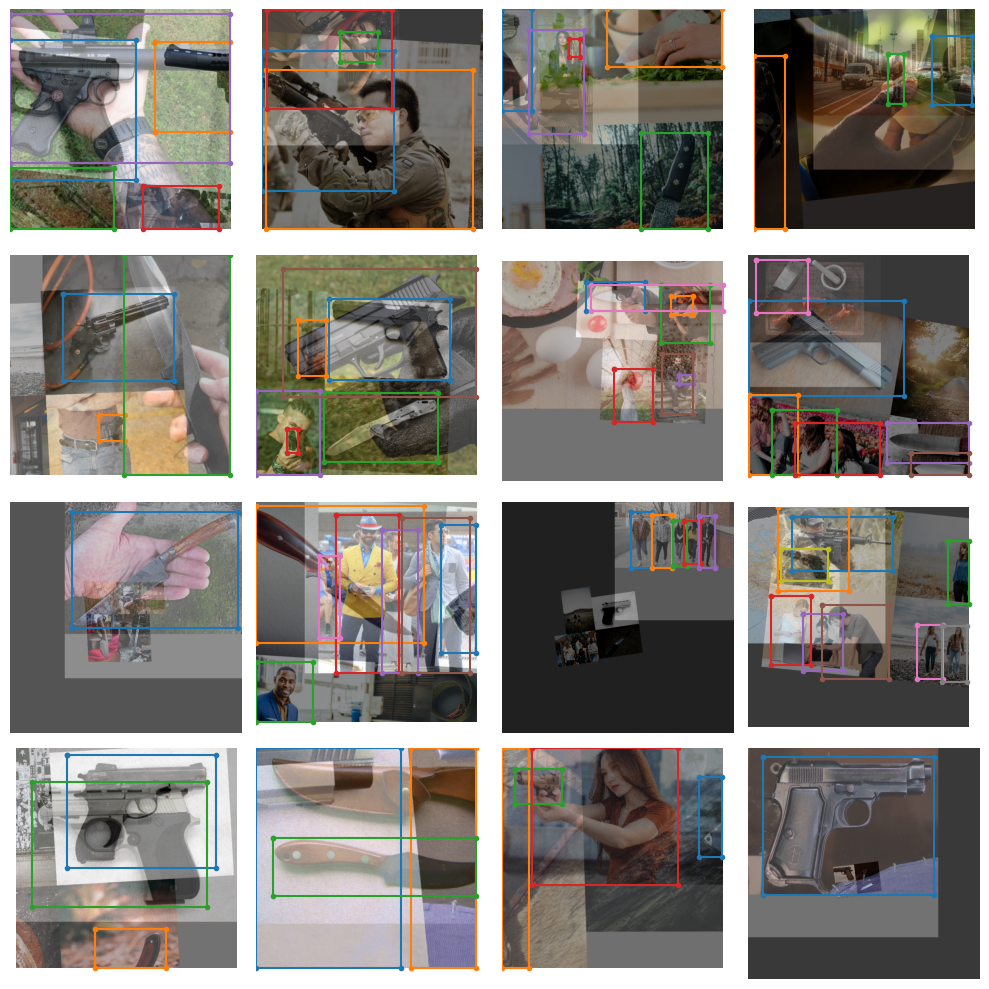

In [11]:
train_data.dataset.plot()

# Instantiating the model

In [8]:
from super_gradients.training import models
model = models.get('yolo_nas_l', 
                   num_classes=len(dataset_params['classes']), 
                   pretrained_weights="coco"
                   )

[2023-08-09 02:25:04] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.


In [ ]:
#torch.cuda.empty_cache()

#  Define metrics and training parameters

You need to define the training parameters for your training run. 

### There are a few **mandatory** arguments that you must define for training params 🚨

- `max_epochs` - Max number of training epochs

- `loss` - the loss function you want to use

- `optimizer` - Optimizer you will be using

- `train_metrics_list` - Metrics to log during training

- `valid_metrics_list` - Metrics to log during training

- `metric_to_watch` - metric which the model checkpoint will be saved according to

You can choose from a variety of `optimizer`'s such as: Adam, AdamW, SGD, Lion, or RMSProps. If you choose to change the defualt parameters of these optimizrs you pass them into `optimizer_params`. 


###  Integrations with experiment monitoring tools

SuperGradients has native integrations with Tensorboard, Weights and Biases, ClearML, and DagsHub. 

If your favorite monitoring tool is not supported by SuperGradients, you can simply implement a class inheriting from BaseSGLogger that you will then pass to the training parameters.

If you're interested in monitoring experiments, you can learn more [in the docs](https://github.com/Deci-AI/super-gradients/blob/0fe46cd39572db34eb83d68e343fed97b8886fe9/documentation/source/experiment_monitoring.md).


### 🪄 SuperGradients offers a number of training tricks right out of the box, such as:

- Exponential moving average
- Zero weight decay on bias and batch normalizatiom
- Weight averaging
- Batch accumulation
- Precise BatchNorm


In [11]:
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback

train_params = {
    # ENABLING SILENT MODE
    # Note: I've enabled silent_mode so the notebook doesn't get longer than it already is.
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-7,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-5,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    # ONLY TRAINING FOR 10 EPOCHS FOR THIS EXAMPLE NOTEBOOK
    "max_epochs": 100,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        # NOTE: num_classes needs to be defined here
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            # NOTE: num_classes needs to be defined here
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

#  Training the model

You've covered a lot of ground so far:

✅ Instantiated the trainer

✅ Defined your dataset parameters and dataloaders

✅ Instantiated a model

✅ Set up your training parameters

### ⏳ Now, its time to train a model 

Training a model using a SuperGradients is done using the `trainer`.


In [12]:
trainer.train(model=model, 
              training_params=train_params, 
              train_loader=train_data, 
              valid_loader=val_data)

The console stream is now moved to checkpoints/wd_yolonas_run/console_Aug03_09_47_44.txt


[2023-08-03 09:47:45] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
[2023-08-03 09:47:59] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Dataset size:                 381        (len(train_set))
    - Batch size per GPU:           8          (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             8          (num_gpus * batch_size)
    - Effective Batch size:         8          (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         47         (len(train_loader))
    - Gradient updates per epoch:   47         (len(train_loader) / batch_accumulate)

[2023-08-03 09:47:59] INFO - sg_trainer.py - Started training for 100 epochs (0/99)

Train epoch 0: 100%|██████████| 47/47 [05:20<00:00,  6.83s/it, PPYoloELoss/loss=3.48, PPYoloELoss/loss_cls

SUMMARY OF EPOCH 0
├── Train
│   ├── Ppyoloeloss/loss_cls = 2.2195
│   ├── Ppyoloeloss/loss_iou = 0.2242
│   ├── Ppyoloeloss/loss_dfl = 1.398
│   └── Ppyoloeloss/loss = 3.479
└── Validation
    ├── Ppyoloeloss/loss_cls = 2.672
    ├── Ppyoloeloss/loss_iou = 0.1286
    ├── Ppyoloeloss/loss_dfl = 1.0335
    ├── Ppyoloeloss/loss = 3.5102
    ├── Precision@0.50 = 0.0
    ├── Recall@0.50 = 0.0
    ├── Map@0.50 = 0.0091
    └── F1@0.50 = 0.0



Train epoch 1: 100%|██████████| 47/47 [06:21<00:00,  8.13s/it, PPYoloELoss/loss=2.88, PPYoloELoss/loss_cls=1.74, PPYoloE
Validating epoch 1: 100%|██████████| 14/14 [00:14<00:00,  1.07s/it]
[2023-08-03 10:00:27] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 10:00:27] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.5595990419387817


SUMMARY OF EPOCH 1
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.7421
│   │   ├── Epoch N-1      = 2.2195 (↘ -0.4773)
│   │   └── Best until now = 2.2195 (↘ -0.4773)
│   ├── Ppyoloeloss/loss_iou = 0.1952
│   │   ├── Epoch N-1      = 0.2242 (↘ -0.029)
│   │   └── Best until now = 0.2242 (↘ -0.029)
│   ├── Ppyoloeloss/loss_dfl = 1.2995
│   │   ├── Epoch N-1      = 1.398  (↘ -0.0985)
│   │   └── Best until now = 1.398  (↘ -0.0985)
│   └── Ppyoloeloss/loss = 2.88
│       ├── Epoch N-1      = 3.479  (↘ -0.599)
│       └── Best until now = 3.479  (↘ -0.599)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.4071
    │   ├── Epoch N-1      = 2.672  (↘ -1.2649)
    │   └── Best until now = 2.672  (↘ -1.2649)
    ├── Ppyoloeloss/loss_iou = 0.1122
    │   ├── Epoch N-1      = 0.1286 (↘ -0.0164)
    │   └── Best until now = 0.1286 (↘ -0.0164)
    ├── Ppyoloeloss/loss_dfl = 0.9239
    │   ├── Epoch N-1      = 1.0335 (↘ -0.1096)
    │   └── Best until now = 1.0335 (↘ -0.1096)
    ├── Ppyoloeloss/loss = 2

Train epoch 2: 100%|██████████| 47/47 [06:58<00:00,  8.91s/it, PPYoloELoss/loss=2.23, PPYoloELoss/loss_cls=1.17, PPYoloE
Validating epoch 2: 100%|██████████| 14/14 [00:14<00:00,  1.05s/it]
[2023-08-03 10:07:51] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 10:07:51] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7234261631965637


SUMMARY OF EPOCH 2
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1681
│   │   ├── Epoch N-1      = 1.7421 (↘ -0.574)
│   │   └── Best until now = 1.7421 (↘ -0.574)
│   ├── Ppyoloeloss/loss_iou = 0.1822
│   │   ├── Epoch N-1      = 0.1952 (↘ -0.0131)
│   │   └── Best until now = 0.1952 (↘ -0.0131)
│   ├── Ppyoloeloss/loss_dfl = 1.2227
│   │   ├── Epoch N-1      = 1.2995 (↘ -0.0768)
│   │   └── Best until now = 1.2995 (↘ -0.0768)
│   └── Ppyoloeloss/loss = 2.2349
│       ├── Epoch N-1      = 2.88   (↘ -0.6451)
│       └── Best until now = 2.88   (↘ -0.6451)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.978
    │   ├── Epoch N-1      = 1.4071 (↘ -0.4291)
    │   └── Best until now = 1.4071 (↘ -0.4291)
    ├── Ppyoloeloss/loss_iou = 0.1244
    │   ├── Epoch N-1      = 0.1122 (↗ 0.0122)
    │   └── Best until now = 0.1122 (↗ 0.0122)
    ├── Ppyoloeloss/loss_dfl = 0.934
    │   ├── Epoch N-1      = 0.9239 (↗ 0.0101)
    │   └── Best until now = 0.9239 (↗ 0.0101)
    ├── Ppyoloeloss/loss = 1.7

Train epoch 3: 100%|██████████| 47/47 [07:05<00:00,  9.06s/it, PPYoloELoss/loss=2.1, PPYoloELoss/loss_cls=1.05, PPYoloEL
Validating epoch 3: 100%|██████████| 14/14 [00:15<00:00,  1.11s/it]
[2023-08-03 10:15:38] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 10:15:38] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8087030053138733


SUMMARY OF EPOCH 3
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0495
│   │   ├── Epoch N-1      = 1.1681 (↘ -0.1186)
│   │   └── Best until now = 1.1681 (↘ -0.1186)
│   ├── Ppyoloeloss/loss_iou = 0.1807
│   │   ├── Epoch N-1      = 0.1822 (↘ -0.0014)
│   │   └── Best until now = 0.1822 (↘ -0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.1947
│   │   ├── Epoch N-1      = 1.2227 (↘ -0.028)
│   │   └── Best until now = 1.2227 (↘ -0.028)
│   └── Ppyoloeloss/loss = 2.0987
│       ├── Epoch N-1      = 2.2349 (↘ -0.1362)
│       └── Best until now = 2.2349 (↘ -0.1362)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8417
    │   ├── Epoch N-1      = 0.978  (↘ -0.1363)
    │   └── Best until now = 0.978  (↘ -0.1363)
    ├── Ppyoloeloss/loss_iou = 0.1247
    │   ├── Epoch N-1      = 0.1244 (↗ 0.0002)
    │   └── Best until now = 0.1122 (↗ 0.0125)
    ├── Ppyoloeloss/loss_dfl = 0.9478
    │   ├── Epoch N-1      = 0.934  (↗ 0.0138)
    │   └── Best until now = 0.9239 (↗ 0.0239)
    ├── Ppyoloeloss/loss = 1

Train epoch 4: 100%|██████████| 47/47 [07:13<00:00,  9.22s/it, PPYoloELoss/loss=2.07, PPYoloELoss/loss_cls=1.03, PPYoloE
Validating epoch 4: 100%|██████████| 14/14 [00:15<00:00,  1.10s/it]
[2023-08-03 10:23:33] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 10:23:33] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8417043089866638


SUMMARY OF EPOCH 4
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0258
│   │   ├── Epoch N-1      = 1.0495 (↘ -0.0237)
│   │   └── Best until now = 1.0495 (↘ -0.0237)
│   ├── Ppyoloeloss/loss_iou = 0.1764
│   │   ├── Epoch N-1      = 0.1807 (↘ -0.0043)
│   │   └── Best until now = 0.1807 (↘ -0.0043)
│   ├── Ppyoloeloss/loss_dfl = 1.2126
│   │   ├── Epoch N-1      = 1.1947 (↗ 0.0179)
│   │   └── Best until now = 1.1947 (↗ 0.0179)
│   └── Ppyoloeloss/loss = 2.0731
│       ├── Epoch N-1      = 2.0987 (↘ -0.0256)
│       └── Best until now = 2.0987 (↘ -0.0256)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8986
    │   ├── Epoch N-1      = 0.8417 (↗ 0.0569)
    │   └── Best until now = 0.8417 (↗ 0.0569)
    ├── Ppyoloeloss/loss_iou = 0.1393
    │   ├── Epoch N-1      = 0.1247 (↗ 0.0147)
    │   └── Best until now = 0.1122 (↗ 0.0272)
    ├── Ppyoloeloss/loss_dfl = 1.023
    │   ├── Epoch N-1      = 0.9478 (↗ 0.0752)
    │   └── Best until now = 0.9239 (↗ 0.0991)
    ├── Ppyoloeloss/loss = 1.75

Train epoch 5: 100%|██████████| 47/47 [07:31<00:00,  9.61s/it, PPYoloELoss/loss=2.06, PPYoloELoss/loss_cls=1.02, PPYoloE
Validating epoch 5: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]
[2023-08-03 10:31:45] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 10:31:45] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8750324845314026


SUMMARY OF EPOCH 5
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0247
│   │   ├── Epoch N-1      = 1.0258 (↘ -0.0011)
│   │   └── Best until now = 1.0258 (↘ -0.0011)
│   ├── Ppyoloeloss/loss_iou = 0.1743
│   │   ├── Epoch N-1      = 0.1764 (↘ -0.0021)
│   │   └── Best until now = 0.1764 (↘ -0.0021)
│   ├── Ppyoloeloss/loss_dfl = 1.1976
│   │   ├── Epoch N-1      = 1.2126 (↘ -0.015)
│   │   └── Best until now = 1.1947 (↗ 0.0029)
│   └── Ppyoloeloss/loss = 2.0594
│       ├── Epoch N-1      = 2.0731 (↘ -0.0137)
│       └── Best until now = 2.0731 (↘ -0.0137)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8306
    │   ├── Epoch N-1      = 0.8986 (↘ -0.0679)
    │   └── Best until now = 0.8417 (↘ -0.011)
    ├── Ppyoloeloss/loss_iou = 0.1262
    │   ├── Epoch N-1      = 0.1393 (↘ -0.0131)
    │   └── Best until now = 0.1122 (↗ 0.014)
    ├── Ppyoloeloss/loss_dfl = 0.9739
    │   ├── Epoch N-1      = 1.023  (↘ -0.0491)
    │   └── Best until now = 0.9239 (↗ 0.0501)
    ├── Ppyoloeloss/loss = 1

Train epoch 6: 100%|██████████| 47/47 [07:30<00:00,  9.58s/it, PPYoloELoss/loss=1.99, PPYoloELoss/loss_cls=0.978, PPYolo
Validating epoch 6: 100%|██████████| 14/14 [00:14<00:00,  1.06s/it]


SUMMARY OF EPOCH 6
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9777
│   │   ├── Epoch N-1      = 1.0247 (↘ -0.0471)
│   │   └── Best until now = 1.0247 (↘ -0.0471)
│   ├── Ppyoloeloss/loss_iou = 0.1709
│   │   ├── Epoch N-1      = 0.1743 (↘ -0.0034)
│   │   └── Best until now = 0.1743 (↘ -0.0034)
│   ├── Ppyoloeloss/loss_dfl = 1.1647
│   │   ├── Epoch N-1      = 1.1976 (↘ -0.0329)
│   │   └── Best until now = 1.1947 (↘ -0.03)
│   └── Ppyoloeloss/loss = 1.9873
│       ├── Epoch N-1      = 2.0594 (↘ -0.0721)
│       └── Best until now = 2.0594 (↘ -0.0721)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8185
    │   ├── Epoch N-1      = 0.8306 (↘ -0.0121)
    │   └── Best until now = 0.8306 (↘ -0.0121)
    ├── Ppyoloeloss/loss_iou = 0.1173
    │   ├── Epoch N-1      = 0.1262 (↘ -0.0089)
    │   └── Best until now = 0.1122 (↗ 0.0051)
    ├── Ppyoloeloss/loss_dfl = 0.9329
    │   ├── Epoch N-1      = 0.9739 (↘ -0.041)
    │   └── Best until now = 0.9239 (↗ 0.0091)
    ├── Ppyoloeloss/loss = 

Train epoch 7: 100%|██████████| 47/47 [07:29<00:00,  9.57s/it, PPYoloELoss/loss=1.97, PPYoloELoss/loss_cls=0.975, PPYolo
Validating epoch 7: 100%|██████████| 14/14 [00:14<00:00,  1.05s/it]


SUMMARY OF EPOCH 7
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.975
│   │   ├── Epoch N-1      = 0.9777 (↘ -0.0027)
│   │   └── Best until now = 0.9777 (↘ -0.0027)
│   ├── Ppyoloeloss/loss_iou = 0.1673
│   │   ├── Epoch N-1      = 0.1709 (↘ -0.0036)
│   │   └── Best until now = 0.1709 (↘ -0.0036)
│   ├── Ppyoloeloss/loss_dfl = 1.1528
│   │   ├── Epoch N-1      = 1.1647 (↘ -0.0119)
│   │   └── Best until now = 1.1647 (↘ -0.0119)
│   └── Ppyoloeloss/loss = 1.9696
│       ├── Epoch N-1      = 1.9873 (↘ -0.0177)
│       └── Best until now = 1.9873 (↘ -0.0177)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8219
    │   ├── Epoch N-1      = 0.8185 (↗ 0.0034)
    │   └── Best until now = 0.8185 (↗ 0.0034)
    ├── Ppyoloeloss/loss_iou = 0.1303
    │   ├── Epoch N-1      = 0.1173 (↗ 0.013)
    │   └── Best until now = 0.1122 (↗ 0.0181)
    ├── Ppyoloeloss/loss_dfl = 0.9617
    │   ├── Epoch N-1      = 0.9329 (↗ 0.0288)
    │   └── Best until now = 0.9239 (↗ 0.0379)
    ├── Ppyoloeloss/loss = 1.6

Train epoch 8: 100%|██████████| 47/47 [07:43<00:00,  9.86s/it, PPYoloELoss/loss=1.94, PPYoloELoss/loss_cls=0.946, PPYolo
Validating epoch 8: 100%|██████████| 14/14 [00:17<00:00,  1.28s/it]


SUMMARY OF EPOCH 8
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9456
│   │   ├── Epoch N-1      = 0.975  (↘ -0.0294)
│   │   └── Best until now = 0.975  (↘ -0.0294)
│   ├── Ppyoloeloss/loss_iou = 0.1668
│   │   ├── Epoch N-1      = 0.1673 (↘ -0.0004)
│   │   └── Best until now = 0.1673 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.1461
│   │   ├── Epoch N-1      = 1.1528 (↘ -0.0067)
│   │   └── Best until now = 1.1528 (↘ -0.0067)
│   └── Ppyoloeloss/loss = 1.9357
│       ├── Epoch N-1      = 1.9696 (↘ -0.0338)
│       └── Best until now = 1.9696 (↘ -0.0338)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8075
    │   ├── Epoch N-1      = 0.8219 (↘ -0.0144)
    │   └── Best until now = 0.8185 (↘ -0.011)
    ├── Ppyoloeloss/loss_iou = 0.1191
    │   ├── Epoch N-1      = 0.1303 (↘ -0.0111)
    │   └── Best until now = 0.1122 (↗ 0.0069)
    ├── Ppyoloeloss/loss_dfl = 0.9387
    │   ├── Epoch N-1      = 0.9617 (↘ -0.023)
    │   └── Best until now = 0.9239 (↗ 0.0149)
    ├── Ppyoloeloss/loss =

Train epoch 9: 100%|██████████| 47/47 [07:34<00:00,  9.66s/it, PPYoloELoss/loss=1.93, PPYoloELoss/loss_cls=0.946, PPYolo
Validating epoch 9: 100%|██████████| 14/14 [00:17<00:00,  1.22s/it]
[2023-08-03 11:04:32] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 11:04:32] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8769428133964539


SUMMARY OF EPOCH 9
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9464
│   │   ├── Epoch N-1      = 0.9456 (↗ 0.0008)
│   │   └── Best until now = 0.9456 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_iou = 0.1652
│   │   ├── Epoch N-1      = 0.1668 (↘ -0.0016)
│   │   └── Best until now = 0.1668 (↘ -0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.1436
│   │   ├── Epoch N-1      = 1.1461 (↘ -0.0026)
│   │   └── Best until now = 1.1461 (↘ -0.0026)
│   └── Ppyoloeloss/loss = 1.9312
│       ├── Epoch N-1      = 1.9357 (↘ -0.0045)
│       └── Best until now = 1.9357 (↘ -0.0045)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7768
    │   ├── Epoch N-1      = 0.8075 (↘ -0.0308)
    │   └── Best until now = 0.8075 (↘ -0.0308)
    ├── Ppyoloeloss/loss_iou = 0.1242
    │   ├── Epoch N-1      = 0.1191 (↗ 0.0051)
    │   └── Best until now = 0.1122 (↗ 0.012)
    ├── Ppyoloeloss/loss_dfl = 0.9504
    │   ├── Epoch N-1      = 0.9387 (↗ 0.0117)
    │   └── Best until now = 0.9239 (↗ 0.0266)
    ├── Ppyoloeloss/loss = 1.

Train epoch 10: 100%|██████████| 47/47 [07:49<00:00,  9.99s/it, PPYoloELoss/loss=1.94, PPYoloELoss/loss_cls=0.945, PPYol
Validating epoch 10: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]


SUMMARY OF EPOCH 10
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.945
│   │   ├── Epoch N-1      = 0.9464 (↘ -0.0013)
│   │   └── Best until now = 0.9456 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_iou = 0.169
│   │   ├── Epoch N-1      = 0.1652 (↗ 0.0038)
│   │   └── Best until now = 0.1652 (↗ 0.0038)
│   ├── Ppyoloeloss/loss_dfl = 1.1482
│   │   ├── Epoch N-1      = 1.1436 (↗ 0.0046)
│   │   └── Best until now = 1.1436 (↗ 0.0046)
│   └── Ppyoloeloss/loss = 1.9417
│       ├── Epoch N-1      = 1.9312 (↗ 0.0105)
│       └── Best until now = 1.9312 (↗ 0.0105)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8288
    │   ├── Epoch N-1      = 0.7768 (↗ 0.052)
    │   └── Best until now = 0.7768 (↗ 0.052)
    ├── Ppyoloeloss/loss_iou = 0.1372
    │   ├── Epoch N-1      = 0.1242 (↗ 0.0129)
    │   └── Best until now = 0.1122 (↗ 0.025)
    ├── Ppyoloeloss/loss_dfl = 0.9666
    │   ├── Epoch N-1      = 0.9504 (↗ 0.0161)
    │   └── Best until now = 0.9239 (↗ 0.0427)
    ├── Ppyoloeloss/loss = 1.655
    │

Train epoch 11: 100%|██████████| 47/47 [07:36<00:00,  9.71s/it, PPYoloELoss/loss=1.94, PPYoloELoss/loss_cls=0.955, PPYol
Validating epoch 11: 100%|██████████| 14/14 [00:18<00:00,  1.30s/it]


SUMMARY OF EPOCH 11
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9549
│   │   ├── Epoch N-1      = 0.945  (↗ 0.0098)
│   │   └── Best until now = 0.945  (↗ 0.0098)
│   ├── Ppyoloeloss/loss_iou = 0.1662
│   │   ├── Epoch N-1      = 0.169  (↘ -0.0028)
│   │   └── Best until now = 0.1652 (↗ 0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.1472
│   │   ├── Epoch N-1      = 1.1482 (↘ -0.0009)
│   │   └── Best until now = 1.1436 (↗ 0.0037)
│   └── Ppyoloeloss/loss = 1.9441
│       ├── Epoch N-1      = 1.9417 (↗ 0.0024)
│       └── Best until now = 1.9312 (↗ 0.0129)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9124
    │   ├── Epoch N-1      = 0.8288 (↗ 0.0836)
    │   └── Best until now = 0.7768 (↗ 0.1357)
    ├── Ppyoloeloss/loss_iou = 0.1367
    │   ├── Epoch N-1      = 0.1372 (↘ -0.0005)
    │   └── Best until now = 0.1122 (↗ 0.0245)
    ├── Ppyoloeloss/loss_dfl = 1.0036
    │   ├── Epoch N-1      = 0.9666 (↗ 0.037)
    │   └── Best until now = 0.9239 (↗ 0.0798)
    ├── Ppyoloeloss/loss = 1.756
 

Train epoch 12: 100%|██████████| 47/47 [07:36<00:00,  9.72s/it, PPYoloELoss/loss=1.9, PPYoloELoss/loss_cls=0.932, PPYolo
Validating epoch 12: 100%|██████████| 14/14 [00:17<00:00,  1.26s/it]


SUMMARY OF EPOCH 12
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9321
│   │   ├── Epoch N-1      = 0.9549 (↘ -0.0228)
│   │   └── Best until now = 0.945  (↘ -0.013)
│   ├── Ppyoloeloss/loss_iou = 0.1627
│   │   ├── Epoch N-1      = 0.1662 (↘ -0.0036)
│   │   └── Best until now = 0.1652 (↘ -0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.1227
│   │   ├── Epoch N-1      = 1.1472 (↘ -0.0245)
│   │   └── Best until now = 1.1436 (↘ -0.0209)
│   └── Ppyoloeloss/loss = 1.9
│       ├── Epoch N-1      = 1.9441 (↘ -0.044)
│       └── Best until now = 1.9312 (↘ -0.0312)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7993
    │   ├── Epoch N-1      = 0.9124 (↘ -0.1131)
    │   └── Best until now = 0.7768 (↗ 0.0225)
    ├── Ppyoloeloss/loss_iou = 0.1321
    │   ├── Epoch N-1      = 0.1367 (↘ -0.0046)
    │   └── Best until now = 0.1122 (↗ 0.0199)
    ├── Ppyoloeloss/loss_dfl = 0.9777
    │   ├── Epoch N-1      = 1.0036 (↘ -0.0259)
    │   └── Best until now = 0.9239 (↗ 0.0539)
    ├── Ppyoloeloss/loss = 1.

Train epoch 13: 100%|██████████| 47/47 [07:31<00:00,  9.60s/it, PPYoloELoss/loss=1.89, PPYoloELoss/loss_cls=0.93, PPYolo
Validating epoch 13: 100%|██████████| 14/14 [00:20<00:00,  1.43s/it]
[2023-08-03 11:38:16] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 11:38:16] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8786924481391907


SUMMARY OF EPOCH 13
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9301
│   │   ├── Epoch N-1      = 0.9321 (↘ -0.0019)
│   │   └── Best until now = 0.9321 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_iou = 0.1608
│   │   ├── Epoch N-1      = 0.1627 (↘ -0.0018)
│   │   └── Best until now = 0.1627 (↘ -0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.1227
│   │   ├── Epoch N-1      = 1.1227 (↘ -0.0)
│   │   └── Best until now = 1.1227 (↘ -0.0)
│   └── Ppyoloeloss/loss = 1.8935
│       ├── Epoch N-1      = 1.9    (↘ -0.0065)
│       └── Best until now = 1.9    (↘ -0.0065)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8069
    │   ├── Epoch N-1      = 0.7993 (↗ 0.0076)
    │   └── Best until now = 0.7768 (↗ 0.0301)
    ├── Ppyoloeloss/loss_iou = 0.136
    │   ├── Epoch N-1      = 0.1321 (↗ 0.0039)
    │   └── Best until now = 0.1122 (↗ 0.0238)
    ├── Ppyoloeloss/loss_dfl = 0.9864
    │   ├── Epoch N-1      = 0.9777 (↗ 0.0086)
    │   └── Best until now = 0.9239 (↗ 0.0625)
    ├── Ppyoloeloss/loss = 1.6401


Train epoch 14: 100%|██████████| 47/47 [07:39<00:00,  9.78s/it, PPYoloELoss/loss=1.91, PPYoloELoss/loss_cls=0.922, PPYol
Validating epoch 14: 100%|██████████| 14/14 [00:17<00:00,  1.26s/it]


SUMMARY OF EPOCH 14
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9223
│   │   ├── Epoch N-1      = 0.9301 (↘ -0.0078)
│   │   └── Best until now = 0.9301 (↘ -0.0078)
│   ├── Ppyoloeloss/loss_iou = 0.1687
│   │   ├── Epoch N-1      = 0.1608 (↗ 0.0078)
│   │   └── Best until now = 0.1608 (↗ 0.0078)
│   ├── Ppyoloeloss/loss_dfl = 1.1412
│   │   ├── Epoch N-1      = 1.1227 (↗ 0.0185)
│   │   └── Best until now = 1.1227 (↗ 0.0185)
│   └── Ppyoloeloss/loss = 1.9145
│       ├── Epoch N-1      = 1.8935 (↗ 0.021)
│       └── Best until now = 1.8935 (↗ 0.021)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8429
    │   ├── Epoch N-1      = 0.8069 (↗ 0.0361)
    │   └── Best until now = 0.7768 (↗ 0.0662)
    ├── Ppyoloeloss/loss_iou = 0.1383
    │   ├── Epoch N-1      = 0.136  (↗ 0.0023)
    │   └── Best until now = 0.1122 (↗ 0.0261)
    ├── Ppyoloeloss/loss_dfl = 1.0022
    │   ├── Epoch N-1      = 0.9864 (↗ 0.0158)
    │   └── Best until now = 0.9239 (↗ 0.0783)
    ├── Ppyoloeloss/loss = 1.6898
 

Train epoch 15: 100%|██████████| 47/47 [07:29<00:00,  9.57s/it, PPYoloELoss/loss=1.88, PPYoloELoss/loss_cls=0.907, PPYol
Validating epoch 15: 100%|██████████| 14/14 [00:17<00:00,  1.26s/it]


SUMMARY OF EPOCH 15
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9069
│   │   ├── Epoch N-1      = 0.9223 (↘ -0.0154)
│   │   └── Best until now = 0.9223 (↘ -0.0154)
│   ├── Ppyoloeloss/loss_iou = 0.164
│   │   ├── Epoch N-1      = 0.1687 (↘ -0.0046)
│   │   └── Best until now = 0.1608 (↗ 0.0032)
│   ├── Ppyoloeloss/loss_dfl = 1.1342
│   │   ├── Epoch N-1      = 1.1412 (↘ -0.007)
│   │   └── Best until now = 1.1227 (↗ 0.0115)
│   └── Ppyoloeloss/loss = 1.884
│       ├── Epoch N-1      = 1.9145 (↘ -0.0305)
│       └── Best until now = 1.8935 (↘ -0.0095)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8212
    │   ├── Epoch N-1      = 0.8429 (↘ -0.0217)
    │   └── Best until now = 0.7768 (↗ 0.0445)
    ├── Ppyoloeloss/loss_iou = 0.1271
    │   ├── Epoch N-1      = 0.1383 (↘ -0.0112)
    │   └── Best until now = 0.1122 (↗ 0.0149)
    ├── Ppyoloeloss/loss_dfl = 0.9677
    │   ├── Epoch N-1      = 1.0022 (↘ -0.0345)
    │   └── Best until now = 0.9239 (↗ 0.0438)
    ├── Ppyoloeloss/loss = 1.

Train epoch 16: 100%|██████████| 47/47 [07:43<00:00,  9.86s/it, PPYoloELoss/loss=1.85, PPYoloELoss/loss_cls=0.894, PPYol
Validating epoch 16: 100%|██████████| 14/14 [00:17<00:00,  1.27s/it]
[2023-08-03 12:03:33] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 12:03:33] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.8964543342590332


SUMMARY OF EPOCH 16
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8936
│   │   ├── Epoch N-1      = 0.9069 (↘ -0.0133)
│   │   └── Best until now = 0.9069 (↘ -0.0133)
│   ├── Ppyoloeloss/loss_iou = 0.1593
│   │   ├── Epoch N-1      = 0.164  (↘ -0.0047)
│   │   └── Best until now = 0.1608 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1104
│   │   ├── Epoch N-1      = 1.1342 (↘ -0.0238)
│   │   └── Best until now = 1.1227 (↘ -0.0123)
│   └── Ppyoloeloss/loss = 1.847
│       ├── Epoch N-1      = 1.884  (↘ -0.037)
│       └── Best until now = 1.884  (↘ -0.037)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7547
    │   ├── Epoch N-1      = 0.8212 (↘ -0.0666)
    │   └── Best until now = 0.7768 (↘ -0.0221)
    ├── Ppyoloeloss/loss_iou = 0.1187
    │   ├── Epoch N-1      = 0.1271 (↘ -0.0083)
    │   └── Best until now = 0.1122 (↗ 0.0065)
    ├── Ppyoloeloss/loss_dfl = 0.9319
    │   ├── Epoch N-1      = 0.9677 (↘ -0.0358)
    │   └── Best until now = 0.9239 (↗ 0.008)
    ├── Ppyoloeloss/loss = 

Train epoch 17: 100%|██████████| 47/47 [07:31<00:00,  9.61s/it, PPYoloELoss/loss=1.84, PPYoloELoss/loss_cls=0.905, PPYol
Validating epoch 17: 100%|██████████| 14/14 [00:15<00:00,  1.08s/it]
[2023-08-03 12:11:52] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 12:11:52] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.9136127829551697


SUMMARY OF EPOCH 17
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9052
│   │   ├── Epoch N-1      = 0.8936 (↗ 0.0116)
│   │   └── Best until now = 0.8936 (↗ 0.0116)
│   ├── Ppyoloeloss/loss_iou = 0.1557
│   │   ├── Epoch N-1      = 0.1593 (↘ -0.0036)
│   │   └── Best until now = 0.1593 (↘ -0.0036)
│   ├── Ppyoloeloss/loss_dfl = 1.1002
│   │   ├── Epoch N-1      = 1.1104 (↘ -0.0102)
│   │   └── Best until now = 1.1104 (↘ -0.0102)
│   └── Ppyoloeloss/loss = 1.8445
│       ├── Epoch N-1      = 1.847  (↘ -0.0025)
│       └── Best until now = 1.847  (↘ -0.0025)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7481
    │   ├── Epoch N-1      = 0.7547 (↘ -0.0066)
    │   └── Best until now = 0.7547 (↘ -0.0066)
    ├── Ppyoloeloss/loss_iou = 0.1337
    │   ├── Epoch N-1      = 0.1187 (↗ 0.0149)
    │   └── Best until now = 0.1122 (↗ 0.0215)
    ├── Ppyoloeloss/loss_dfl = 0.9635
    │   ├── Epoch N-1      = 0.9319 (↗ 0.0317)
    │   └── Best until now = 0.9239 (↗ 0.0397)
    ├── Ppyoloeloss/loss = 

Train epoch 18: 100%|██████████| 47/47 [07:39<00:00,  9.78s/it, PPYoloELoss/loss=1.85, PPYoloELoss/loss_cls=0.909, PPYol
Validating epoch 18: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 18
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9092
│   │   ├── Epoch N-1      = 0.9052 (↗ 0.004)
│   │   └── Best until now = 0.8936 (↗ 0.0156)
│   ├── Ppyoloeloss/loss_iou = 0.1572
│   │   ├── Epoch N-1      = 0.1557 (↗ 0.0015)
│   │   └── Best until now = 0.1557 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1025
│   │   ├── Epoch N-1      = 1.1002 (↗ 0.0023)
│   │   └── Best until now = 1.1002 (↗ 0.0023)
│   └── Ppyoloeloss/loss = 1.8534
│       ├── Epoch N-1      = 1.8445 (↗ 0.009)
│       └── Best until now = 1.8445 (↗ 0.009)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7821
    │   ├── Epoch N-1      = 0.7481 (↗ 0.0341)
    │   └── Best until now = 0.7481 (↗ 0.0341)
    ├── Ppyoloeloss/loss_iou = 0.1368
    │   ├── Epoch N-1      = 0.1337 (↗ 0.0031)
    │   └── Best until now = 0.1122 (↗ 0.0246)
    ├── Ppyoloeloss/loss_dfl = 0.9957
    │   ├── Epoch N-1      = 0.9635 (↗ 0.0322)
    │   └── Best until now = 0.9239 (↗ 0.0718)
    ├── Ppyoloeloss/loss = 1.6219
    

Train epoch 19: 100%|██████████| 47/47 [07:41<00:00,  9.82s/it, PPYoloELoss/loss=1.82, PPYoloELoss/loss_cls=0.879, PPYol
Validating epoch 19: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]


SUMMARY OF EPOCH 19
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8791
│   │   ├── Epoch N-1      = 0.9092 (↘ -0.03)
│   │   └── Best until now = 0.8936 (↘ -0.0144)
│   ├── Ppyoloeloss/loss_iou = 0.1576
│   │   ├── Epoch N-1      = 0.1572 (↗ 0.0004)
│   │   └── Best until now = 0.1557 (↗ 0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.1015
│   │   ├── Epoch N-1      = 1.1025 (↘ -0.001)
│   │   └── Best until now = 1.1002 (↗ 0.0013)
│   └── Ppyoloeloss/loss = 1.8239
│       ├── Epoch N-1      = 1.8534 (↘ -0.0296)
│       └── Best until now = 1.8445 (↘ -0.0206)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7663
    │   ├── Epoch N-1      = 0.7821 (↘ -0.0158)
    │   └── Best until now = 0.7481 (↗ 0.0183)
    ├── Ppyoloeloss/loss_iou = 0.1293
    │   ├── Epoch N-1      = 0.1368 (↘ -0.0075)
    │   └── Best until now = 0.1122 (↗ 0.0171)
    ├── Ppyoloeloss/loss_dfl = 0.9515
    │   ├── Epoch N-1      = 0.9957 (↘ -0.0442)
    │   └── Best until now = 0.9239 (↗ 0.0276)
    ├── Ppyoloeloss/loss = 1.5

Train epoch 20: 100%|██████████| 47/47 [07:27<00:00,  9.52s/it, PPYoloELoss/loss=1.87, PPYoloELoss/loss_cls=0.909, PPYol
Validating epoch 20: 100%|██████████| 14/14 [00:15<00:00,  1.08s/it]


SUMMARY OF EPOCH 20
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9089
│   │   ├── Epoch N-1      = 0.8791 (↗ 0.0298)
│   │   └── Best until now = 0.8791 (↗ 0.0298)
│   ├── Ppyoloeloss/loss_iou = 0.161
│   │   ├── Epoch N-1      = 0.1576 (↗ 0.0034)
│   │   └── Best until now = 0.1557 (↗ 0.0053)
│   ├── Ppyoloeloss/loss_dfl = 1.113
│   │   ├── Epoch N-1      = 1.1015 (↗ 0.0115)
│   │   └── Best until now = 1.1002 (↗ 0.0129)
│   └── Ppyoloeloss/loss = 1.868
│       ├── Epoch N-1      = 1.8239 (↗ 0.0441)
│       └── Best until now = 1.8239 (↗ 0.0441)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7555
    │   ├── Epoch N-1      = 0.7663 (↘ -0.0109)
    │   └── Best until now = 0.7481 (↗ 0.0074)
    ├── Ppyoloeloss/loss_iou = 0.1281
    │   ├── Epoch N-1      = 0.1293 (↘ -0.0012)
    │   └── Best until now = 0.1122 (↗ 0.0159)
    ├── Ppyoloeloss/loss_dfl = 0.9589
    │   ├── Epoch N-1      = 0.9515 (↗ 0.0074)
    │   └── Best until now = 0.9239 (↗ 0.035)
    ├── Ppyoloeloss/loss = 1.5552
   

Train epoch 21: 100%|██████████| 47/47 [07:39<00:00,  9.78s/it, PPYoloELoss/loss=1.81, PPYoloELoss/loss_cls=0.874, PPYol
Validating epoch 21: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 21
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8738
│   │   ├── Epoch N-1      = 0.9089 (↘ -0.0351)
│   │   └── Best until now = 0.8791 (↘ -0.0053)
│   ├── Ppyoloeloss/loss_iou = 0.1563
│   │   ├── Epoch N-1      = 0.161  (↘ -0.0047)
│   │   └── Best until now = 0.1557 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.0872
│   │   ├── Epoch N-1      = 1.113  (↘ -0.0258)
│   │   └── Best until now = 1.1002 (↘ -0.013)
│   └── Ppyoloeloss/loss = 1.8083
│       ├── Epoch N-1      = 1.868  (↘ -0.0597)
│       └── Best until now = 1.8239 (↘ -0.0156)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7541
    │   ├── Epoch N-1      = 0.7555 (↘ -0.0013)
    │   └── Best until now = 0.7481 (↗ 0.0061)
    ├── Ppyoloeloss/loss_iou = 0.1257
    │   ├── Epoch N-1      = 0.1281 (↘ -0.0024)
    │   └── Best until now = 0.1122 (↗ 0.0135)
    ├── Ppyoloeloss/loss_dfl = 0.9525
    │   ├── Epoch N-1      = 0.9589 (↘ -0.0064)
    │   └── Best until now = 0.9239 (↗ 0.0286)
    ├── Ppyoloeloss/loss =

Train epoch 22: 100%|██████████| 47/47 [07:34<00:00,  9.67s/it, PPYoloELoss/loss=1.8, PPYoloELoss/loss_cls=0.871, PPYolo
Validating epoch 22: 100%|██████████| 14/14 [00:17<00:00,  1.27s/it]


SUMMARY OF EPOCH 22
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8713
│   │   ├── Epoch N-1      = 0.8738 (↘ -0.0025)
│   │   └── Best until now = 0.8738 (↘ -0.0025)
│   ├── Ppyoloeloss/loss_iou = 0.1527
│   │   ├── Epoch N-1      = 0.1563 (↘ -0.0037)
│   │   └── Best until now = 0.1557 (↘ -0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.087
│   │   ├── Epoch N-1      = 1.0872 (↘ -0.0002)
│   │   └── Best until now = 1.0872 (↘ -0.0002)
│   └── Ppyoloeloss/loss = 1.7965
│       ├── Epoch N-1      = 1.8083 (↘ -0.0118)
│       └── Best until now = 1.8083 (↘ -0.0118)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8234
    │   ├── Epoch N-1      = 0.7541 (↗ 0.0692)
    │   └── Best until now = 0.7481 (↗ 0.0753)
    ├── Ppyoloeloss/loss_iou = 0.1404
    │   ├── Epoch N-1      = 0.1257 (↗ 0.0147)
    │   └── Best until now = 0.1122 (↗ 0.0282)
    ├── Ppyoloeloss/loss_dfl = 1.0206
    │   ├── Epoch N-1      = 0.9525 (↗ 0.0681)
    │   └── Best until now = 0.9239 (↗ 0.0967)
    ├── Ppyoloeloss/loss = 1.

Train epoch 23: 100%|██████████| 47/47 [07:43<00:00,  9.86s/it, PPYoloELoss/loss=1.81, PPYoloELoss/loss_cls=0.872, PPYol
Validating epoch 23: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 23
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8717
│   │   ├── Epoch N-1      = 0.8713 (↗ 0.0004)
│   │   └── Best until now = 0.8713 (↗ 0.0004)
│   ├── Ppyoloeloss/loss_iou = 0.1543
│   │   ├── Epoch N-1      = 0.1527 (↗ 0.0016)
│   │   └── Best until now = 0.1527 (↗ 0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.102
│   │   ├── Epoch N-1      = 1.087  (↗ 0.015)
│   │   └── Best until now = 1.087  (↗ 0.015)
│   └── Ppyoloeloss/loss = 1.8083
│       ├── Epoch N-1      = 1.7965 (↗ 0.0119)
│       └── Best until now = 1.7965 (↗ 0.0119)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7885
    │   ├── Epoch N-1      = 0.8234 (↘ -0.0349)
    │   └── Best until now = 0.7481 (↗ 0.0404)
    ├── Ppyoloeloss/loss_iou = 0.1312
    │   ├── Epoch N-1      = 0.1404 (↘ -0.0092)
    │   └── Best until now = 0.1122 (↗ 0.019)
    ├── Ppyoloeloss/loss_dfl = 0.978
    │   ├── Epoch N-1      = 1.0206 (↘ -0.0425)
    │   └── Best until now = 0.9239 (↗ 0.0542)
    ├── Ppyoloeloss/loss = 1.6055
   

Train epoch 24: 100%|██████████| 47/47 [07:39<00:00,  9.78s/it, PPYoloELoss/loss=1.8, PPYoloELoss/loss_cls=0.872, PPYolo
Validating epoch 24: 100%|██████████| 14/14 [00:16<00:00,  1.19s/it]


SUMMARY OF EPOCH 24
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8721
│   │   ├── Epoch N-1      = 0.8717 (↗ 0.0004)
│   │   └── Best until now = 0.8713 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_iou = 0.1558
│   │   ├── Epoch N-1      = 0.1543 (↗ 0.0015)
│   │   └── Best until now = 0.1527 (↗ 0.0031)
│   ├── Ppyoloeloss/loss_dfl = 1.0844
│   │   ├── Epoch N-1      = 1.102  (↘ -0.0176)
│   │   └── Best until now = 1.087  (↘ -0.0026)
│   └── Ppyoloeloss/loss = 1.8037
│       ├── Epoch N-1      = 1.8083 (↘ -0.0046)
│       └── Best until now = 1.7965 (↗ 0.0072)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7809
    │   ├── Epoch N-1      = 0.7885 (↘ -0.0075)
    │   └── Best until now = 0.7481 (↗ 0.0329)
    ├── Ppyoloeloss/loss_iou = 0.1342
    │   ├── Epoch N-1      = 0.1312 (↗ 0.003)
    │   └── Best until now = 0.1122 (↗ 0.022)
    ├── Ppyoloeloss/loss_dfl = 1.0011
    │   ├── Epoch N-1      = 0.978  (↗ 0.023)
    │   └── Best until now = 0.9239 (↗ 0.0772)
    ├── Ppyoloeloss/loss = 1.6169


Train epoch 25: 100%|██████████| 47/47 [07:38<00:00,  9.76s/it, PPYoloELoss/loss=1.82, PPYoloELoss/loss_cls=0.883, PPYol
Validating epoch 25: 100%|██████████| 14/14 [00:17<00:00,  1.27s/it]


SUMMARY OF EPOCH 25
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8826
│   │   ├── Epoch N-1      = 0.8721 (↗ 0.0105)
│   │   └── Best until now = 0.8713 (↗ 0.0113)
│   ├── Ppyoloeloss/loss_iou = 0.1547
│   │   ├── Epoch N-1      = 0.1558 (↘ -0.001)
│   │   └── Best until now = 0.1527 (↗ 0.0021)
│   ├── Ppyoloeloss/loss_dfl = 1.0947
│   │   ├── Epoch N-1      = 1.0844 (↗ 0.0102)
│   │   └── Best until now = 1.0844 (↗ 0.0102)
│   └── Ppyoloeloss/loss = 1.8168
│       ├── Epoch N-1      = 1.8037 (↗ 0.0131)
│       └── Best until now = 1.7965 (↗ 0.0203)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8165
    │   ├── Epoch N-1      = 0.7809 (↗ 0.0355)
    │   └── Best until now = 0.7481 (↗ 0.0684)
    ├── Ppyoloeloss/loss_iou = 0.1286
    │   ├── Epoch N-1      = 0.1342 (↘ -0.0056)
    │   └── Best until now = 0.1122 (↗ 0.0164)
    ├── Ppyoloeloss/loss_dfl = 0.9677
    │   ├── Epoch N-1      = 1.0011 (↘ -0.0334)
    │   └── Best until now = 0.9239 (↗ 0.0438)
    ├── Ppyoloeloss/loss = 1.6218

Train epoch 26: 100%|██████████| 47/47 [07:36<00:00,  9.71s/it, PPYoloELoss/loss=1.8, PPYoloELoss/loss_cls=0.874, PPYolo
Validating epoch 26: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 26
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8736
│   │   ├── Epoch N-1      = 0.8826 (↘ -0.009)
│   │   └── Best until now = 0.8713 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_iou = 0.1545
│   │   ├── Epoch N-1      = 0.1547 (↘ -0.0002)
│   │   └── Best until now = 0.1527 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.0792
│   │   ├── Epoch N-1      = 1.0947 (↘ -0.0155)
│   │   └── Best until now = 1.0844 (↘ -0.0053)
│   └── Ppyoloeloss/loss = 1.7995
│       ├── Epoch N-1      = 1.8168 (↘ -0.0173)
│       └── Best until now = 1.7965 (↗ 0.003)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9021
    │   ├── Epoch N-1      = 0.8165 (↗ 0.0856)
    │   └── Best until now = 0.7481 (↗ 0.154)
    ├── Ppyoloeloss/loss_iou = 0.1261
    │   ├── Epoch N-1      = 0.1286 (↘ -0.0025)
    │   └── Best until now = 0.1122 (↗ 0.0139)
    ├── Ppyoloeloss/loss_dfl = 0.9564
    │   ├── Epoch N-1      = 0.9677 (↘ -0.0113)
    │   └── Best until now = 0.9239 (↗ 0.0325)
    ├── Ppyoloeloss/loss = 1.69

Train epoch 27: 100%|██████████| 47/47 [07:39<00:00,  9.77s/it, PPYoloELoss/loss=1.8, PPYoloELoss/loss_cls=0.867, PPYolo
Validating epoch 27: 100%|██████████| 14/14 [00:17<00:00,  1.25s/it]


SUMMARY OF EPOCH 27
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8672
│   │   ├── Epoch N-1      = 0.8736 (↘ -0.0064)
│   │   └── Best until now = 0.8713 (↘ -0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.1529
│   │   ├── Epoch N-1      = 0.1545 (↘ -0.0016)
│   │   └── Best until now = 0.1527 (↗ 0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.0922
│   │   ├── Epoch N-1      = 1.0792 (↗ 0.013)
│   │   └── Best until now = 1.0792 (↗ 0.013)
│   └── Ppyoloeloss/loss = 1.7956
│       ├── Epoch N-1      = 1.7995 (↘ -0.0039)
│       └── Best until now = 1.7965 (↘ -0.0008)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7829
    │   ├── Epoch N-1      = 0.9021 (↘ -0.1191)
    │   └── Best until now = 0.7481 (↗ 0.0349)
    ├── Ppyoloeloss/loss_iou = 0.1292
    │   ├── Epoch N-1      = 0.1261 (↗ 0.0031)
    │   └── Best until now = 0.1122 (↗ 0.017)
    ├── Ppyoloeloss/loss_dfl = 0.9573
    │   ├── Epoch N-1      = 0.9564 (↗ 0.0009)
    │   └── Best until now = 0.9239 (↗ 0.0334)
    ├── Ppyoloeloss/loss = 1.584

Train epoch 28: 100%|██████████| 47/47 [07:27<00:00,  9.52s/it, PPYoloELoss/loss=1.78, PPYoloELoss/loss_cls=0.865, PPYol
Validating epoch 28: 100%|██████████| 14/14 [00:15<00:00,  1.07s/it]


SUMMARY OF EPOCH 28
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8646
│   │   ├── Epoch N-1      = 0.8672 (↘ -0.0027)
│   │   └── Best until now = 0.8672 (↘ -0.0027)
│   ├── Ppyoloeloss/loss_iou = 0.1518
│   │   ├── Epoch N-1      = 0.1529 (↘ -0.0011)
│   │   └── Best until now = 0.1527 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.0657
│   │   ├── Epoch N-1      = 1.0922 (↘ -0.0264)
│   │   └── Best until now = 1.0792 (↘ -0.0134)
│   └── Ppyoloeloss/loss = 1.777
│       ├── Epoch N-1      = 1.7956 (↘ -0.0186)
│       └── Best until now = 1.7956 (↘ -0.0186)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7864
    │   ├── Epoch N-1      = 0.7829 (↗ 0.0035)
    │   └── Best until now = 0.7481 (↗ 0.0384)
    ├── Ppyoloeloss/loss_iou = 0.1393
    │   ├── Epoch N-1      = 0.1292 (↗ 0.01)
    │   └── Best until now = 0.1122 (↗ 0.0271)
    ├── Ppyoloeloss/loss_dfl = 1.0087
    │   ├── Epoch N-1      = 0.9573 (↗ 0.0514)
    │   └── Best until now = 0.9239 (↗ 0.0848)
    ├── Ppyoloeloss/loss = 1.6

Train epoch 29: 100%|██████████| 47/47 [07:35<00:00,  9.70s/it, PPYoloELoss/loss=1.77, PPYoloELoss/loss_cls=0.856, PPYol
Validating epoch 29: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 29
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8559
│   │   ├── Epoch N-1      = 0.8646 (↘ -0.0086)
│   │   └── Best until now = 0.8646 (↘ -0.0086)
│   ├── Ppyoloeloss/loss_iou = 0.1531
│   │   ├── Epoch N-1      = 0.1518 (↗ 0.0013)
│   │   └── Best until now = 0.1518 (↗ 0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.0695
│   │   ├── Epoch N-1      = 1.0657 (↗ 0.0038)
│   │   └── Best until now = 1.0657 (↗ 0.0038)
│   └── Ppyoloeloss/loss = 1.7735
│       ├── Epoch N-1      = 1.777  (↘ -0.0034)
│       └── Best until now = 1.777  (↘ -0.0034)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8009
    │   ├── Epoch N-1      = 0.7864 (↗ 0.0145)
    │   └── Best until now = 0.7481 (↗ 0.0529)
    ├── Ppyoloeloss/loss_iou = 0.1294
    │   ├── Epoch N-1      = 0.1393 (↘ -0.0099)
    │   └── Best until now = 0.1122 (↗ 0.0172)
    ├── Ppyoloeloss/loss_dfl = 0.9645
    │   ├── Epoch N-1      = 1.0087 (↘ -0.0441)
    │   └── Best until now = 0.9239 (↗ 0.0406)
    ├── Ppyoloeloss/loss = 1.

Train epoch 30: 100%|██████████| 47/47 [07:34<00:00,  9.66s/it, PPYoloELoss/loss=1.78, PPYoloELoss/loss_cls=0.855, PPYol
Validating epoch 30: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 30
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8552
│   │   ├── Epoch N-1      = 0.8559 (↘ -0.0007)
│   │   └── Best until now = 0.8559 (↘ -0.0007)
│   ├── Ppyoloeloss/loss_iou = 0.1538
│   │   ├── Epoch N-1      = 0.1531 (↗ 0.0006)
│   │   └── Best until now = 0.1518 (↗ 0.002)
│   ├── Ppyoloeloss/loss_dfl = 1.0726
│   │   ├── Epoch N-1      = 1.0695 (↗ 0.003)
│   │   └── Best until now = 1.0657 (↗ 0.0068)
│   └── Ppyoloeloss/loss = 1.7759
│       ├── Epoch N-1      = 1.7735 (↗ 0.0024)
│       └── Best until now = 1.7735 (↗ 0.0024)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7826
    │   ├── Epoch N-1      = 0.8009 (↘ -0.0183)
    │   └── Best until now = 0.7481 (↗ 0.0346)
    ├── Ppyoloeloss/loss_iou = 0.1331
    │   ├── Epoch N-1      = 0.1294 (↗ 0.0038)
    │   └── Best until now = 0.1122 (↗ 0.0209)
    ├── Ppyoloeloss/loss_dfl = 0.9684
    │   ├── Epoch N-1      = 0.9645 (↗ 0.0039)
    │   └── Best until now = 0.9239 (↗ 0.0445)
    ├── Ppyoloeloss/loss = 1.5997


Train epoch 31: 100%|██████████| 47/47 [07:22<00:00,  9.41s/it, PPYoloELoss/loss=1.78, PPYoloELoss/loss_cls=0.862, PPYol
Validating epoch 31: 100%|██████████| 14/14 [00:17<00:00,  1.23s/it]


SUMMARY OF EPOCH 31
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.862
│   │   ├── Epoch N-1      = 0.8552 (↗ 0.0067)
│   │   └── Best until now = 0.8552 (↗ 0.0067)
│   ├── Ppyoloeloss/loss_iou = 0.1535
│   │   ├── Epoch N-1      = 0.1538 (↘ -0.0003)
│   │   └── Best until now = 0.1518 (↗ 0.0017)
│   ├── Ppyoloeloss/loss_dfl = 1.071
│   │   ├── Epoch N-1      = 1.0726 (↘ -0.0016)
│   │   └── Best until now = 1.0657 (↗ 0.0053)
│   └── Ppyoloeloss/loss = 1.7812
│       ├── Epoch N-1      = 1.7759 (↗ 0.0053)
│       └── Best until now = 1.7735 (↗ 0.0077)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.855
    │   ├── Epoch N-1      = 0.7826 (↗ 0.0724)
    │   └── Best until now = 0.7481 (↗ 0.107)
    ├── Ppyoloeloss/loss_iou = 0.1365
    │   ├── Epoch N-1      = 0.1331 (↗ 0.0034)
    │   └── Best until now = 0.1122 (↗ 0.0243)
    ├── Ppyoloeloss/loss_dfl = 0.9785
    │   ├── Epoch N-1      = 0.9684 (↗ 0.0101)
    │   └── Best until now = 0.9239 (↗ 0.0546)
    ├── Ppyoloeloss/loss = 1.6855
   

Train epoch 32: 100%|██████████| 47/47 [07:31<00:00,  9.60s/it, PPYoloELoss/loss=1.75, PPYoloELoss/loss_cls=0.847, PPYol
Validating epoch 32: 100%|██████████| 14/14 [00:16<00:00,  1.15s/it]


SUMMARY OF EPOCH 32
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8466
│   │   ├── Epoch N-1      = 0.862  (↘ -0.0153)
│   │   └── Best until now = 0.8552 (↘ -0.0086)
│   ├── Ppyoloeloss/loss_iou = 0.1496
│   │   ├── Epoch N-1      = 0.1535 (↘ -0.0039)
│   │   └── Best until now = 0.1518 (↘ -0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.064
│   │   ├── Epoch N-1      = 1.071  (↘ -0.007)
│   │   └── Best until now = 1.0657 (↘ -0.0018)
│   └── Ppyoloeloss/loss = 1.7525
│       ├── Epoch N-1      = 1.7812 (↘ -0.0287)
│       └── Best until now = 1.7735 (↘ -0.0211)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7447
    │   ├── Epoch N-1      = 0.855  (↘ -0.1103)
    │   └── Best until now = 0.7481 (↘ -0.0033)
    ├── Ppyoloeloss/loss_iou = 0.1362
    │   ├── Epoch N-1      = 0.1365 (↘ -0.0003)
    │   └── Best until now = 0.1122 (↗ 0.024)
    ├── Ppyoloeloss/loss_dfl = 0.9812
    │   ├── Epoch N-1      = 0.9785 (↗ 0.0027)
    │   └── Best until now = 0.9239 (↗ 0.0573)
    ├── Ppyoloeloss/loss = 

Train epoch 33: 100%|██████████| 47/47 [07:30<00:00,  9.59s/it, PPYoloELoss/loss=1.77, PPYoloELoss/loss_cls=0.863, PPYol
Validating epoch 33: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 33
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8633
│   │   ├── Epoch N-1      = 0.8466 (↗ 0.0167)
│   │   └── Best until now = 0.8466 (↗ 0.0167)
│   ├── Ppyoloeloss/loss_iou = 0.1499
│   │   ├── Epoch N-1      = 0.1496 (↗ 0.0003)
│   │   └── Best until now = 0.1496 (↗ 0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.0636
│   │   ├── Epoch N-1      = 1.064  (↘ -0.0004)
│   │   └── Best until now = 1.064  (↘ -0.0004)
│   └── Ppyoloeloss/loss = 1.7698
│       ├── Epoch N-1      = 1.7525 (↗ 0.0173)
│       └── Best until now = 1.7525 (↗ 0.0173)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7772
    │   ├── Epoch N-1      = 0.7447 (↗ 0.0325)
    │   └── Best until now = 0.7447 (↗ 0.0325)
    ├── Ppyoloeloss/loss_iou = 0.1327
    │   ├── Epoch N-1      = 0.1362 (↘ -0.0035)
    │   └── Best until now = 0.1122 (↗ 0.0205)
    ├── Ppyoloeloss/loss_dfl = 0.9605
    │   ├── Epoch N-1      = 0.9812 (↘ -0.0207)
    │   └── Best until now = 0.9239 (↗ 0.0366)
    ├── Ppyoloeloss/loss = 1.58

Train epoch 34: 100%|██████████| 47/47 [07:39<00:00,  9.78s/it, PPYoloELoss/loss=1.76, PPYoloELoss/loss_cls=0.843, PPYol
Validating epoch 34: 100%|██████████| 14/14 [00:17<00:00,  1.23s/it]


SUMMARY OF EPOCH 34
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.843
│   │   ├── Epoch N-1      = 0.8633 (↘ -0.0203)
│   │   └── Best until now = 0.8466 (↘ -0.0036)
│   ├── Ppyoloeloss/loss_iou = 0.1535
│   │   ├── Epoch N-1      = 0.1499 (↗ 0.0036)
│   │   └── Best until now = 0.1496 (↗ 0.0039)
│   ├── Ppyoloeloss/loss_dfl = 1.0643
│   │   ├── Epoch N-1      = 1.0636 (↗ 0.0007)
│   │   └── Best until now = 1.0636 (↗ 0.0007)
│   └── Ppyoloeloss/loss = 1.7589
│       ├── Epoch N-1      = 1.7698 (↘ -0.0109)
│       └── Best until now = 1.7525 (↗ 0.0064)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7767
    │   ├── Epoch N-1      = 0.7772 (↘ -0.0005)
    │   └── Best until now = 0.7447 (↗ 0.032)
    ├── Ppyoloeloss/loss_iou = 0.1363
    │   ├── Epoch N-1      = 0.1327 (↗ 0.0036)
    │   └── Best until now = 0.1122 (↗ 0.0241)
    ├── Ppyoloeloss/loss_dfl = 0.9646
    │   ├── Epoch N-1      = 0.9605 (↗ 0.0041)
    │   └── Best until now = 0.9239 (↗ 0.0407)
    ├── Ppyoloeloss/loss = 1.5998

Train epoch 35: 100%|██████████| 47/47 [07:22<00:00,  9.41s/it, PPYoloELoss/loss=1.69, PPYoloELoss/loss_cls=0.809, PPYol
Validating epoch 35: 100%|██████████| 14/14 [00:17<00:00,  1.27s/it]


SUMMARY OF EPOCH 35
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8093
│   │   ├── Epoch N-1      = 0.843  (↘ -0.0338)
│   │   └── Best until now = 0.843  (↘ -0.0338)
│   ├── Ppyoloeloss/loss_iou = 0.1453
│   │   ├── Epoch N-1      = 0.1535 (↘ -0.0082)
│   │   └── Best until now = 0.1496 (↘ -0.0042)
│   ├── Ppyoloeloss/loss_dfl = 1.0347
│   │   ├── Epoch N-1      = 1.0643 (↘ -0.0295)
│   │   └── Best until now = 1.0636 (↘ -0.0289)
│   └── Ppyoloeloss/loss = 1.69
│       ├── Epoch N-1      = 1.7589 (↘ -0.0689)
│       └── Best until now = 1.7525 (↘ -0.0625)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7279
    │   ├── Epoch N-1      = 0.7767 (↘ -0.0488)
    │   └── Best until now = 0.7447 (↘ -0.0169)
    ├── Ppyoloeloss/loss_iou = 0.13
    │   ├── Epoch N-1      = 0.1363 (↘ -0.0063)
    │   └── Best until now = 0.1122 (↗ 0.0178)
    ├── Ppyoloeloss/loss_dfl = 0.94
    │   ├── Epoch N-1      = 0.9646 (↘ -0.0245)
    │   └── Best until now = 0.9239 (↗ 0.0162)
    ├── Ppyoloeloss/loss = 1.

Train epoch 36: 100%|██████████| 47/47 [07:30<00:00,  9.58s/it, PPYoloELoss/loss=1.73, PPYoloELoss/loss_cls=0.833, PPYol
Validating epoch 36: 100%|██████████| 14/14 [00:17<00:00,  1.25s/it]


SUMMARY OF EPOCH 36
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8334
│   │   ├── Epoch N-1      = 0.8093 (↗ 0.0241)
│   │   └── Best until now = 0.8093 (↗ 0.0241)
│   ├── Ppyoloeloss/loss_iou = 0.1475
│   │   ├── Epoch N-1      = 0.1453 (↗ 0.0021)
│   │   └── Best until now = 0.1453 (↗ 0.0021)
│   ├── Ppyoloeloss/loss_dfl = 1.0571
│   │   ├── Epoch N-1      = 1.0347 (↗ 0.0224)
│   │   └── Best until now = 1.0347 (↗ 0.0224)
│   └── Ppyoloeloss/loss = 1.7306
│       ├── Epoch N-1      = 1.69   (↗ 0.0406)
│       └── Best until now = 1.69   (↗ 0.0406)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7583
    │   ├── Epoch N-1      = 0.7279 (↗ 0.0305)
    │   └── Best until now = 0.7279 (↗ 0.0305)
    ├── Ppyoloeloss/loss_iou = 0.1326
    │   ├── Epoch N-1      = 0.13   (↗ 0.0026)
    │   └── Best until now = 0.1122 (↗ 0.0204)
    ├── Ppyoloeloss/loss_dfl = 0.9545
    │   ├── Epoch N-1      = 0.94   (↗ 0.0145)
    │   └── Best until now = 0.9239 (↗ 0.0307)
    ├── Ppyoloeloss/loss = 1.5671
 

Train epoch 37: 100%|██████████| 47/47 [07:35<00:00,  9.69s/it, PPYoloELoss/loss=1.74, PPYoloELoss/loss_cls=0.841, PPYol
Validating epoch 37: 100%|██████████| 14/14 [00:18<00:00,  1.29s/it]


SUMMARY OF EPOCH 37
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8414
│   │   ├── Epoch N-1      = 0.8334 (↗ 0.008)
│   │   └── Best until now = 0.8093 (↗ 0.0321)
│   ├── Ppyoloeloss/loss_iou = 0.147
│   │   ├── Epoch N-1      = 0.1475 (↘ -0.0005)
│   │   └── Best until now = 0.1453 (↗ 0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.0605
│   │   ├── Epoch N-1      = 1.0571 (↗ 0.0034)
│   │   └── Best until now = 1.0347 (↗ 0.0257)
│   └── Ppyoloeloss/loss = 1.739
│       ├── Epoch N-1      = 1.7306 (↗ 0.0085)
│       └── Best until now = 1.69   (↗ 0.0491)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7653
    │   ├── Epoch N-1      = 0.7583 (↗ 0.007)
    │   └── Best until now = 0.7279 (↗ 0.0374)
    ├── Ppyoloeloss/loss_iou = 0.1335
    │   ├── Epoch N-1      = 0.1326 (↗ 0.0009)
    │   └── Best until now = 0.1122 (↗ 0.0213)
    ├── Ppyoloeloss/loss_dfl = 0.969
    │   ├── Epoch N-1      = 0.9545 (↗ 0.0145)
    │   └── Best until now = 0.9239 (↗ 0.0451)
    ├── Ppyoloeloss/loss = 1.5835
    │

Train epoch 38: 100%|██████████| 47/47 [07:11<00:00,  9.19s/it, PPYoloELoss/loss=1.72, PPYoloELoss/loss_cls=0.825, PPYol
Validating epoch 38: 100%|██████████| 14/14 [00:17<00:00,  1.22s/it]


SUMMARY OF EPOCH 38
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.825
│   │   ├── Epoch N-1      = 0.8414 (↘ -0.0163)
│   │   └── Best until now = 0.8093 (↗ 0.0158)
│   ├── Ppyoloeloss/loss_iou = 0.1487
│   │   ├── Epoch N-1      = 0.147  (↗ 0.0018)
│   │   └── Best until now = 0.1453 (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 1.0482
│   │   ├── Epoch N-1      = 1.0605 (↘ -0.0123)
│   │   └── Best until now = 1.0347 (↗ 0.0135)
│   └── Ppyoloeloss/loss = 1.7209
│       ├── Epoch N-1      = 1.739  (↘ -0.0181)
│       └── Best until now = 1.69   (↗ 0.031)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7781
    │   ├── Epoch N-1      = 0.7653 (↗ 0.0128)
    │   └── Best until now = 0.7279 (↗ 0.0502)
    ├── Ppyoloeloss/loss_iou = 0.1334
    │   ├── Epoch N-1      = 0.1335 (↘ -1e-04)
    │   └── Best until now = 0.1122 (↗ 0.0212)
    ├── Ppyoloeloss/loss_dfl = 0.9798
    │   ├── Epoch N-1      = 0.969  (↗ 0.0108)
    │   └── Best until now = 0.9239 (↗ 0.0559)
    ├── Ppyoloeloss/loss = 1.6015


Train epoch 39: 100%|██████████| 47/47 [07:34<00:00,  9.68s/it, PPYoloELoss/loss=1.73, PPYoloELoss/loss_cls=0.834, PPYol
Validating epoch 39: 100%|██████████| 14/14 [00:15<00:00,  1.10s/it]


SUMMARY OF EPOCH 39
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8339
│   │   ├── Epoch N-1      = 0.825  (↗ 0.0089)
│   │   └── Best until now = 0.8093 (↗ 0.0247)
│   ├── Ppyoloeloss/loss_iou = 0.15
│   │   ├── Epoch N-1      = 0.1487 (↗ 0.0013)
│   │   └── Best until now = 0.1453 (↗ 0.0047)
│   ├── Ppyoloeloss/loss_dfl = 1.0514
│   │   ├── Epoch N-1      = 1.0482 (↗ 0.0032)
│   │   └── Best until now = 1.0347 (↗ 0.0166)
│   └── Ppyoloeloss/loss = 1.7347
│       ├── Epoch N-1      = 1.7209 (↗ 0.0138)
│       └── Best until now = 1.69   (↗ 0.0447)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7514
    │   ├── Epoch N-1      = 0.7781 (↘ -0.0267)
    │   └── Best until now = 0.7279 (↗ 0.0236)
    ├── Ppyoloeloss/loss_iou = 0.1338
    │   ├── Epoch N-1      = 0.1334 (↗ 0.0004)
    │   └── Best until now = 0.1122 (↗ 0.0216)
    ├── Ppyoloeloss/loss_dfl = 0.9648
    │   ├── Epoch N-1      = 0.9798 (↘ -0.015)
    │   └── Best until now = 0.9239 (↗ 0.0409)
    ├── Ppyoloeloss/loss = 1.5684
  

Train epoch 40: 100%|██████████| 47/47 [07:42<00:00,  9.85s/it, PPYoloELoss/loss=1.7, PPYoloELoss/loss_cls=0.822, PPYolo
Validating epoch 40: 100%|██████████| 14/14 [00:17<00:00,  1.21s/it]


SUMMARY OF EPOCH 40
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8224
│   │   ├── Epoch N-1      = 0.8339 (↘ -0.0115)
│   │   └── Best until now = 0.8093 (↗ 0.0132)
│   ├── Ppyoloeloss/loss_iou = 0.145
│   │   ├── Epoch N-1      = 0.15   (↘ -0.005)
│   │   └── Best until now = 0.1453 (↘ -0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.0282
│   │   ├── Epoch N-1      = 1.0514 (↘ -0.0232)
│   │   └── Best until now = 1.0347 (↘ -0.0065)
│   └── Ppyoloeloss/loss = 1.6991
│       ├── Epoch N-1      = 1.7347 (↘ -0.0357)
│       └── Best until now = 1.69   (↗ 0.0091)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7767
    │   ├── Epoch N-1      = 0.7514 (↗ 0.0252)
    │   └── Best until now = 0.7279 (↗ 0.0488)
    ├── Ppyoloeloss/loss_iou = 0.1263
    │   ├── Epoch N-1      = 0.1338 (↘ -0.0076)
    │   └── Best until now = 0.1122 (↗ 0.0141)
    ├── Ppyoloeloss/loss_dfl = 0.9323
    │   ├── Epoch N-1      = 0.9648 (↘ -0.0325)
    │   └── Best until now = 0.9239 (↗ 0.0084)
    ├── Ppyoloeloss/loss = 1.

Train epoch 41: 100%|██████████| 47/47 [07:41<00:00,  9.81s/it, PPYoloELoss/loss=1.7, PPYoloELoss/loss_cls=0.824, PPYolo
Validating epoch 41: 100%|██████████| 14/14 [00:17<00:00,  1.26s/it]


SUMMARY OF EPOCH 41
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8237
│   │   ├── Epoch N-1      = 0.8224 (↗ 0.0012)
│   │   └── Best until now = 0.8093 (↗ 0.0144)
│   ├── Ppyoloeloss/loss_iou = 0.1439
│   │   ├── Epoch N-1      = 0.145  (↘ -0.0011)
│   │   └── Best until now = 0.145  (↘ -0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.0345
│   │   ├── Epoch N-1      = 1.0282 (↗ 0.0063)
│   │   └── Best until now = 1.0282 (↗ 0.0063)
│   └── Ppyoloeloss/loss = 1.7006
│       ├── Epoch N-1      = 1.6991 (↗ 0.0015)
│       └── Best until now = 1.69   (↗ 0.0106)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8177
    │   ├── Epoch N-1      = 0.7767 (↗ 0.0411)
    │   └── Best until now = 0.7279 (↗ 0.0899)
    ├── Ppyoloeloss/loss_iou = 0.1467
    │   ├── Epoch N-1      = 0.1263 (↗ 0.0205)
    │   └── Best until now = 0.1122 (↗ 0.0345)
    ├── Ppyoloeloss/loss_dfl = 1.0019
    │   ├── Epoch N-1      = 0.9323 (↗ 0.0696)
    │   └── Best until now = 0.9239 (↗ 0.078)
    ├── Ppyoloeloss/loss = 1.6855


Train epoch 42: 100%|██████████| 47/47 [07:34<00:00,  9.67s/it, PPYoloELoss/loss=1.69, PPYoloELoss/loss_cls=0.816, PPYol
Validating epoch 42: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 42
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8161
│   │   ├── Epoch N-1      = 0.8237 (↘ -0.0075)
│   │   └── Best until now = 0.8093 (↗ 0.0069)
│   ├── Ppyoloeloss/loss_iou = 0.144
│   │   ├── Epoch N-1      = 0.1439 (↗ 1e-04)
│   │   └── Best until now = 0.1439 (↗ 1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0186
│   │   ├── Epoch N-1      = 1.0345 (↘ -0.0159)
│   │   └── Best until now = 1.0282 (↘ -0.0095)
│   └── Ppyoloeloss/loss = 1.6854
│       ├── Epoch N-1      = 1.7006 (↘ -0.0152)
│       └── Best until now = 1.69   (↘ -0.0046)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7743
    │   ├── Epoch N-1      = 0.8177 (↘ -0.0434)
    │   └── Best until now = 0.7279 (↗ 0.0464)
    ├── Ppyoloeloss/loss_iou = 0.1267
    │   ├── Epoch N-1      = 0.1467 (↘ -0.0201)
    │   └── Best until now = 0.1122 (↗ 0.0145)
    ├── Ppyoloeloss/loss_dfl = 0.9433
    │   ├── Epoch N-1      = 1.0019 (↘ -0.0586)
    │   └── Best until now = 0.9239 (↗ 0.0194)
    ├── Ppyoloeloss/loss = 1.5

Train epoch 43: 100%|██████████| 47/47 [07:38<00:00,  9.75s/it, PPYoloELoss/loss=1.7, PPYoloELoss/loss_cls=0.819, PPYolo
Validating epoch 43: 100%|██████████| 14/14 [00:17<00:00,  1.26s/it]


SUMMARY OF EPOCH 43
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8194
│   │   ├── Epoch N-1      = 0.8161 (↗ 0.0033)
│   │   └── Best until now = 0.8093 (↗ 0.0101)
│   ├── Ppyoloeloss/loss_iou = 0.1451
│   │   ├── Epoch N-1      = 0.144  (↗ 0.0011)
│   │   └── Best until now = 0.1439 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.0374
│   │   ├── Epoch N-1      = 1.0186 (↗ 0.0188)
│   │   └── Best until now = 1.0186 (↗ 0.0188)
│   └── Ppyoloeloss/loss = 1.7009
│       ├── Epoch N-1      = 1.6854 (↗ 0.0155)
│       └── Best until now = 1.6854 (↗ 0.0155)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7632
    │   ├── Epoch N-1      = 0.7743 (↘ -0.0111)
    │   └── Best until now = 0.7279 (↗ 0.0353)
    ├── Ppyoloeloss/loss_iou = 0.1325
    │   ├── Epoch N-1      = 0.1267 (↗ 0.0058)
    │   └── Best until now = 0.1122 (↗ 0.0203)
    ├── Ppyoloeloss/loss_dfl = 0.9613
    │   ├── Epoch N-1      = 0.9433 (↗ 0.0181)
    │   └── Best until now = 0.9239 (↗ 0.0375)
    ├── Ppyoloeloss/loss = 1.575
 

Train epoch 44: 100%|██████████| 47/47 [07:33<00:00,  9.65s/it, PPYoloELoss/loss=1.69, PPYoloELoss/loss_cls=0.81, PPYolo
Validating epoch 44: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 44
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8101
│   │   ├── Epoch N-1      = 0.8194 (↘ -0.0093)
│   │   └── Best until now = 0.8093 (↗ 0.0009)
│   ├── Ppyoloeloss/loss_iou = 0.1447
│   │   ├── Epoch N-1      = 0.1451 (↘ -0.0004)
│   │   └── Best until now = 0.1439 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.035
│   │   ├── Epoch N-1      = 1.0374 (↘ -0.0024)
│   │   └── Best until now = 1.0186 (↗ 0.0164)
│   └── Ppyoloeloss/loss = 1.6894
│       ├── Epoch N-1      = 1.7009 (↘ -0.0115)
│       └── Best until now = 1.6854 (↗ 0.004)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7741
    │   ├── Epoch N-1      = 0.7632 (↗ 0.0109)
    │   └── Best until now = 0.7279 (↗ 0.0462)
    ├── Ppyoloeloss/loss_iou = 0.1299
    │   ├── Epoch N-1      = 0.1325 (↘ -0.0025)
    │   └── Best until now = 0.1122 (↗ 0.0177)
    ├── Ppyoloeloss/loss_dfl = 0.9618
    │   ├── Epoch N-1      = 0.9613 (↗ 0.0004)
    │   └── Best until now = 0.9239 (↗ 0.0379)
    ├── Ppyoloeloss/loss = 1.579

Train epoch 45: 100%|██████████| 47/47 [07:38<00:00,  9.75s/it, PPYoloELoss/loss=1.68, PPYoloELoss/loss_cls=0.81, PPYolo
Validating epoch 45: 100%|██████████| 14/14 [00:16<00:00,  1.19s/it]


SUMMARY OF EPOCH 45
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8102
│   │   ├── Epoch N-1      = 0.8101 (↗ 0.0)
│   │   └── Best until now = 0.8093 (↗ 0.0009)
│   ├── Ppyoloeloss/loss_iou = 0.1424
│   │   ├── Epoch N-1      = 0.1447 (↘ -0.0023)
│   │   └── Best until now = 0.1439 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.0269
│   │   ├── Epoch N-1      = 1.035  (↘ -0.0081)
│   │   └── Best until now = 1.0186 (↗ 0.0083)
│   └── Ppyoloeloss/loss = 1.6797
│       ├── Epoch N-1      = 1.6894 (↘ -0.0097)
│       └── Best until now = 1.6854 (↘ -0.0058)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7831
    │   ├── Epoch N-1      = 0.7741 (↗ 0.009)
    │   └── Best until now = 0.7279 (↗ 0.0553)
    ├── Ppyoloeloss/loss_iou = 0.1304
    │   ├── Epoch N-1      = 0.1299 (↗ 0.0005)
    │   └── Best until now = 0.1122 (↗ 0.0182)
    ├── Ppyoloeloss/loss_dfl = 0.97
    │   ├── Epoch N-1      = 0.9618 (↗ 0.0082)
    │   └── Best until now = 0.9239 (↗ 0.0461)
    ├── Ppyoloeloss/loss = 1.5942
  

Train epoch 46: 100%|██████████| 47/47 [07:41<00:00,  9.82s/it, PPYoloELoss/loss=1.68, PPYoloELoss/loss_cls=0.807, PPYol
Validating epoch 46: 100%|██████████| 14/14 [00:17<00:00,  1.21s/it]


SUMMARY OF EPOCH 46
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8071
│   │   ├── Epoch N-1      = 0.8102 (↘ -0.003)
│   │   └── Best until now = 0.8093 (↘ -0.0021)
│   ├── Ppyoloeloss/loss_iou = 0.1441
│   │   ├── Epoch N-1      = 0.1424 (↗ 0.0016)
│   │   └── Best until now = 0.1424 (↗ 0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.0201
│   │   ├── Epoch N-1      = 1.0269 (↘ -0.0068)
│   │   └── Best until now = 1.0186 (↗ 0.0014)
│   └── Ppyoloeloss/loss = 1.6773
│       ├── Epoch N-1      = 1.6797 (↘ -0.0023)
│       └── Best until now = 1.6797 (↘ -0.0023)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7976
    │   ├── Epoch N-1      = 0.7831 (↗ 0.0144)
    │   └── Best until now = 0.7279 (↗ 0.0697)
    ├── Ppyoloeloss/loss_iou = 0.1259
    │   ├── Epoch N-1      = 0.1304 (↘ -0.0045)
    │   └── Best until now = 0.1122 (↗ 0.0137)
    ├── Ppyoloeloss/loss_dfl = 0.9564
    │   ├── Epoch N-1      = 0.97   (↘ -0.0136)
    │   └── Best until now = 0.9239 (↗ 0.0325)
    ├── Ppyoloeloss/loss = 1.

Train epoch 47: 100%|██████████| 47/47 [07:37<00:00,  9.72s/it, PPYoloELoss/loss=1.67, PPYoloELoss/loss_cls=0.804, PPYol
Validating epoch 47: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]


SUMMARY OF EPOCH 47
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8043
│   │   ├── Epoch N-1      = 0.8071 (↘ -0.0028)
│   │   └── Best until now = 0.8071 (↘ -0.0028)
│   ├── Ppyoloeloss/loss_iou = 0.1429
│   │   ├── Epoch N-1      = 0.1441 (↘ -0.0012)
│   │   └── Best until now = 0.1424 (↗ 0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0202
│   │   ├── Epoch N-1      = 1.0201 (↗ 0.0002)
│   │   └── Best until now = 1.0186 (↗ 0.0016)
│   └── Ppyoloeloss/loss = 1.6716
│       ├── Epoch N-1      = 1.6773 (↘ -0.0057)
│       └── Best until now = 1.6773 (↘ -0.0057)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7503
    │   ├── Epoch N-1      = 0.7976 (↘ -0.0473)
    │   └── Best until now = 0.7279 (↗ 0.0224)
    ├── Ppyoloeloss/loss_iou = 0.13
    │   ├── Epoch N-1      = 0.1259 (↗ 0.0041)
    │   └── Best until now = 0.1122 (↗ 0.0178)
    ├── Ppyoloeloss/loss_dfl = 0.9442
    │   ├── Epoch N-1      = 0.9564 (↘ -0.0121)
    │   └── Best until now = 0.9239 (↗ 0.0204)
    ├── Ppyoloeloss/loss = 1.5

Train epoch 48: 100%|██████████| 47/47 [07:36<00:00,  9.71s/it, PPYoloELoss/loss=1.69, PPYoloELoss/loss_cls=0.809, PPYol
Validating epoch 48: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 48
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8091
│   │   ├── Epoch N-1      = 0.8043 (↗ 0.0048)
│   │   └── Best until now = 0.8043 (↗ 0.0048)
│   ├── Ppyoloeloss/loss_iou = 0.1446
│   │   ├── Epoch N-1      = 0.1429 (↗ 0.0018)
│   │   └── Best until now = 0.1424 (↗ 0.0022)
│   ├── Ppyoloeloss/loss_dfl = 1.0345
│   │   ├── Epoch N-1      = 1.0202 (↗ 0.0142)
│   │   └── Best until now = 1.0186 (↗ 0.0158)
│   └── Ppyoloeloss/loss = 1.688
│       ├── Epoch N-1      = 1.6716 (↗ 0.0163)
│       └── Best until now = 1.6716 (↗ 0.0163)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7497
    │   ├── Epoch N-1      = 0.7503 (↘ -0.0006)
    │   └── Best until now = 0.7279 (↗ 0.0218)
    ├── Ppyoloeloss/loss_iou = 0.1407
    │   ├── Epoch N-1      = 0.13   (↗ 0.0107)
    │   └── Best until now = 0.1122 (↗ 0.0285)
    ├── Ppyoloeloss/loss_dfl = 0.9897
    │   ├── Epoch N-1      = 0.9442 (↗ 0.0455)
    │   └── Best until now = 0.9239 (↗ 0.0659)
    ├── Ppyoloeloss/loss = 1.5964
 

Train epoch 49: 100%|██████████| 47/47 [07:50<00:00, 10.01s/it, PPYoloELoss/loss=1.69, PPYoloELoss/loss_cls=0.819, PPYol
Validating epoch 49: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 49
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8185
│   │   ├── Epoch N-1      = 0.8091 (↗ 0.0094)
│   │   └── Best until now = 0.8043 (↗ 0.0142)
│   ├── Ppyoloeloss/loss_iou = 0.1431
│   │   ├── Epoch N-1      = 0.1446 (↘ -0.0016)
│   │   └── Best until now = 0.1424 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.032
│   │   ├── Epoch N-1      = 1.0345 (↘ -0.0025)
│   │   └── Best until now = 1.0186 (↗ 0.0134)
│   └── Ppyoloeloss/loss = 1.6922
│       ├── Epoch N-1      = 1.688  (↗ 0.0042)
│       └── Best until now = 1.6716 (↗ 0.0206)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.733
    │   ├── Epoch N-1      = 0.7497 (↘ -0.0167)
    │   └── Best until now = 0.7279 (↗ 0.0051)
    ├── Ppyoloeloss/loss_iou = 0.1314
    │   ├── Epoch N-1      = 0.1407 (↘ -0.0093)
    │   └── Best until now = 0.1122 (↗ 0.0192)
    ├── Ppyoloeloss/loss_dfl = 0.9574
    │   ├── Epoch N-1      = 0.9897 (↘ -0.0323)
    │   └── Best until now = 0.9239 (↗ 0.0336)
    ├── Ppyoloeloss/loss = 1.540

Train epoch 50: 100%|██████████| 47/47 [07:44<00:00,  9.88s/it, PPYoloELoss/loss=1.68, PPYoloELoss/loss_cls=0.807, PPYol
Validating epoch 50: 100%|██████████| 14/14 [00:19<00:00,  1.38s/it]


SUMMARY OF EPOCH 50
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8066
│   │   ├── Epoch N-1      = 0.8185 (↘ -0.012)
│   │   └── Best until now = 0.8043 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_iou = 0.1421
│   │   ├── Epoch N-1      = 0.1431 (↘ -0.001)
│   │   └── Best until now = 0.1424 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.0322
│   │   ├── Epoch N-1      = 1.032  (↗ 0.0002)
│   │   └── Best until now = 1.0186 (↗ 0.0135)
│   └── Ppyoloeloss/loss = 1.6778
│       ├── Epoch N-1      = 1.6922 (↘ -0.0144)
│       └── Best until now = 1.6716 (↗ 0.0062)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7478
    │   ├── Epoch N-1      = 0.733  (↗ 0.0148)
    │   └── Best until now = 0.7279 (↗ 0.02)
    ├── Ppyoloeloss/loss_iou = 0.1309
    │   ├── Epoch N-1      = 0.1314 (↘ -0.0005)
    │   └── Best until now = 0.1122 (↗ 0.0187)
    ├── Ppyoloeloss/loss_dfl = 0.9614
    │   ├── Epoch N-1      = 0.9574 (↗ 0.004)
    │   └── Best until now = 0.9239 (↗ 0.0375)
    ├── Ppyoloeloss/loss = 1.5559
 

Train epoch 51: 100%|██████████| 47/47 [07:25<00:00,  9.48s/it, PPYoloELoss/loss=1.65, PPYoloELoss/loss_cls=0.79, PPYolo
Validating epoch 51: 100%|██████████| 14/14 [00:17<00:00,  1.26s/it]


SUMMARY OF EPOCH 51
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7902
│   │   ├── Epoch N-1      = 0.8066 (↘ -0.0164)
│   │   └── Best until now = 0.8043 (↘ -0.0141)
│   ├── Ppyoloeloss/loss_iou = 0.141
│   │   ├── Epoch N-1      = 0.1421 (↘ -0.001)
│   │   └── Best until now = 0.1421 (↘ -0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.0178
│   │   ├── Epoch N-1      = 1.0322 (↘ -0.0143)
│   │   └── Best until now = 1.0186 (↘ -0.0008)
│   └── Ppyoloeloss/loss = 1.6516
│       ├── Epoch N-1      = 1.6778 (↘ -0.0262)
│       └── Best until now = 1.6716 (↘ -0.02)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7529
    │   ├── Epoch N-1      = 0.7478 (↗ 0.0051)
    │   └── Best until now = 0.7279 (↗ 0.025)
    ├── Ppyoloeloss/loss_iou = 0.1362
    │   ├── Epoch N-1      = 0.1309 (↗ 0.0052)
    │   └── Best until now = 0.1122 (↗ 0.024)
    ├── Ppyoloeloss/loss_dfl = 0.9751
    │   ├── Epoch N-1      = 0.9614 (↗ 0.0137)
    │   └── Best until now = 0.9239 (↗ 0.0512)
    ├── Ppyoloeloss/loss = 1.5809


Train epoch 52: 100%|██████████| 47/47 [07:14<00:00,  9.23s/it, PPYoloELoss/loss=1.64, PPYoloELoss/loss_cls=0.786, PPYol
Validating epoch 52: 100%|██████████| 14/14 [00:26<00:00,  1.93s/it]


SUMMARY OF EPOCH 52
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7861
│   │   ├── Epoch N-1      = 0.7902 (↘ -0.0041)
│   │   └── Best until now = 0.7902 (↘ -0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.1396
│   │   ├── Epoch N-1      = 0.141  (↘ -0.0014)
│   │   └── Best until now = 0.141  (↘ -0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.006
│   │   ├── Epoch N-1      = 1.0178 (↘ -0.0119)
│   │   └── Best until now = 1.0178 (↘ -0.0119)
│   └── Ppyoloeloss/loss = 1.6381
│       ├── Epoch N-1      = 1.6516 (↘ -0.0135)
│       └── Best until now = 1.6516 (↘ -0.0135)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7417
    │   ├── Epoch N-1      = 0.7529 (↘ -0.0112)
    │   └── Best until now = 0.7279 (↗ 0.0138)
    ├── Ppyoloeloss/loss_iou = 0.1318
    │   ├── Epoch N-1      = 0.1362 (↘ -0.0044)
    │   └── Best until now = 0.1122 (↗ 0.0196)
    ├── Ppyoloeloss/loss_dfl = 0.9483
    │   ├── Epoch N-1      = 0.9751 (↘ -0.0267)
    │   └── Best until now = 0.9239 (↗ 0.0245)
    ├── Ppyoloeloss/loss 

Train epoch 53: 100%|██████████| 47/47 [07:41<00:00,  9.82s/it, PPYoloELoss/loss=1.64, PPYoloELoss/loss_cls=0.795, PPYol
Validating epoch 53: 100%|██████████| 14/14 [00:17<00:00,  1.23s/it]


SUMMARY OF EPOCH 53
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7949
│   │   ├── Epoch N-1      = 0.7861 (↗ 0.0088)
│   │   └── Best until now = 0.7861 (↗ 0.0088)
│   ├── Ppyoloeloss/loss_iou = 0.1373
│   │   ├── Epoch N-1      = 0.1396 (↘ -0.0023)
│   │   └── Best until now = 0.1396 (↘ -0.0023)
│   ├── Ppyoloeloss/loss_dfl = 0.997
│   │   ├── Epoch N-1      = 1.006  (↘ -0.009)
│   │   └── Best until now = 1.006  (↘ -0.009)
│   └── Ppyoloeloss/loss = 1.6366
│       ├── Epoch N-1      = 1.6381 (↘ -0.0016)
│       └── Best until now = 1.6381 (↘ -0.0016)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7385
    │   ├── Epoch N-1      = 0.7417 (↘ -0.0032)
    │   └── Best until now = 0.7279 (↗ 0.0106)
    ├── Ppyoloeloss/loss_iou = 0.1299
    │   ├── Epoch N-1      = 0.1318 (↘ -0.0019)
    │   └── Best until now = 0.1122 (↗ 0.0177)
    ├── Ppyoloeloss/loss_dfl = 0.9552
    │   ├── Epoch N-1      = 0.9483 (↗ 0.0069)
    │   └── Best until now = 0.9239 (↗ 0.0313)
    ├── Ppyoloeloss/loss = 1.5

Train epoch 54: 100%|██████████| 47/47 [07:13<00:00,  9.23s/it, PPYoloELoss/loss=1.66, PPYoloELoss/loss_cls=0.796, PPYol
Validating epoch 54: 100%|██████████| 14/14 [00:16<00:00,  1.19s/it]


SUMMARY OF EPOCH 54
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7964
│   │   ├── Epoch N-1      = 0.7949 (↗ 0.0014)
│   │   └── Best until now = 0.7861 (↗ 0.0103)
│   ├── Ppyoloeloss/loss_iou = 0.1424
│   │   ├── Epoch N-1      = 0.1373 (↗ 0.0051)
│   │   └── Best until now = 0.1373 (↗ 0.0051)
│   ├── Ppyoloeloss/loss_dfl = 1.0191
│   │   ├── Epoch N-1      = 0.997  (↗ 0.0221)
│   │   └── Best until now = 0.997  (↗ 0.0221)
│   └── Ppyoloeloss/loss = 1.6619
│       ├── Epoch N-1      = 1.6366 (↗ 0.0253)
│       └── Best until now = 1.6366 (↗ 0.0253)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7212
    │   ├── Epoch N-1      = 0.7385 (↘ -0.0173)
    │   └── Best until now = 0.7279 (↘ -0.0066)
    ├── Ppyoloeloss/loss_iou = 0.1293
    │   ├── Epoch N-1      = 0.1299 (↘ -0.0007)
    │   └── Best until now = 0.1122 (↗ 0.0171)
    ├── Ppyoloeloss/loss_dfl = 0.9505
    │   ├── Epoch N-1      = 0.9552 (↘ -0.0047)
    │   └── Best until now = 0.9239 (↗ 0.0266)
    ├── Ppyoloeloss/loss = 1.51

Train epoch 55: 100%|██████████| 47/47 [07:23<00:00,  9.43s/it, PPYoloELoss/loss=1.59, PPYoloELoss/loss_cls=0.774, PPYol
Validating epoch 55: 100%|██████████| 14/14 [00:14<00:00,  1.07s/it]


SUMMARY OF EPOCH 55
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7736
│   │   ├── Epoch N-1      = 0.7964 (↘ -0.0227)
│   │   └── Best until now = 0.7861 (↘ -0.0125)
│   ├── Ppyoloeloss/loss_iou = 0.1318
│   │   ├── Epoch N-1      = 0.1424 (↘ -0.0106)
│   │   └── Best until now = 0.1373 (↘ -0.0054)
│   ├── Ppyoloeloss/loss_dfl = 0.9771
│   │   ├── Epoch N-1      = 1.0191 (↘ -0.0419)
│   │   └── Best until now = 0.997  (↘ -0.0198)
│   └── Ppyoloeloss/loss = 1.5918
│       ├── Epoch N-1      = 1.6619 (↘ -0.0701)
│       └── Best until now = 1.6366 (↘ -0.0448)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7634
    │   ├── Epoch N-1      = 0.7212 (↗ 0.0421)
    │   └── Best until now = 0.7212 (↗ 0.0421)
    ├── Ppyoloeloss/loss_iou = 0.1352
    │   ├── Epoch N-1      = 0.1293 (↗ 0.0059)
    │   └── Best until now = 0.1122 (↗ 0.023)
    ├── Ppyoloeloss/loss_dfl = 0.9625
    │   ├── Epoch N-1      = 0.9505 (↗ 0.0121)
    │   └── Best until now = 0.9239 (↗ 0.0387)
    ├── Ppyoloeloss/loss = 1

Train epoch 56: 100%|██████████| 47/47 [07:34<00:00,  9.67s/it, PPYoloELoss/loss=1.64, PPYoloELoss/loss_cls=0.777, PPYol
Validating epoch 56: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]


SUMMARY OF EPOCH 56
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7765
│   │   ├── Epoch N-1      = 0.7736 (↗ 0.0029)
│   │   └── Best until now = 0.7736 (↗ 0.0029)
│   ├── Ppyoloeloss/loss_iou = 0.1405
│   │   ├── Epoch N-1      = 0.1318 (↗ 0.0087)
│   │   └── Best until now = 0.1318 (↗ 0.0087)
│   ├── Ppyoloeloss/loss_dfl = 1.0212
│   │   ├── Epoch N-1      = 0.9771 (↗ 0.044)
│   │   └── Best until now = 0.9771 (↗ 0.044)
│   └── Ppyoloeloss/loss = 1.6383
│       ├── Epoch N-1      = 1.5918 (↗ 0.0466)
│       └── Best until now = 1.5918 (↗ 0.0466)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7881
    │   ├── Epoch N-1      = 0.7634 (↗ 0.0247)
    │   └── Best until now = 0.7212 (↗ 0.0668)
    ├── Ppyoloeloss/loss_iou = 0.1424
    │   ├── Epoch N-1      = 0.1352 (↗ 0.0072)
    │   └── Best until now = 0.1122 (↗ 0.0302)
    ├── Ppyoloeloss/loss_dfl = 0.9742
    │   ├── Epoch N-1      = 0.9625 (↗ 0.0117)
    │   └── Best until now = 0.9239 (↗ 0.0504)
    ├── Ppyoloeloss/loss = 1.6312
   

Train epoch 57: 100%|██████████| 47/47 [07:34<00:00,  9.66s/it, PPYoloELoss/loss=1.62, PPYoloELoss/loss_cls=0.783, PPYol
Validating epoch 57: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 57
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7834
│   │   ├── Epoch N-1      = 0.7765 (↗ 0.0069)
│   │   └── Best until now = 0.7736 (↗ 0.0098)
│   ├── Ppyoloeloss/loss_iou = 0.1342
│   │   ├── Epoch N-1      = 0.1405 (↘ -0.0063)
│   │   └── Best until now = 0.1318 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0001
│   │   ├── Epoch N-1      = 1.0212 (↘ -0.0211)
│   │   └── Best until now = 0.9771 (↗ 0.0229)
│   └── Ppyoloeloss/loss = 1.6188
│       ├── Epoch N-1      = 1.6383 (↘ -0.0195)
│       └── Best until now = 1.5918 (↗ 0.027)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7556
    │   ├── Epoch N-1      = 0.7881 (↘ -0.0324)
    │   └── Best until now = 0.7212 (↗ 0.0344)
    ├── Ppyoloeloss/loss_iou = 0.1398
    │   ├── Epoch N-1      = 0.1424 (↘ -0.0026)
    │   └── Best until now = 0.1122 (↗ 0.0276)
    ├── Ppyoloeloss/loss_dfl = 0.9892
    │   ├── Epoch N-1      = 0.9742 (↗ 0.015)
    │   └── Best until now = 0.9239 (↗ 0.0653)
    ├── Ppyoloeloss/loss = 1.599

Train epoch 58: 100%|██████████| 47/47 [07:25<00:00,  9.47s/it, PPYoloELoss/loss=1.63, PPYoloELoss/loss_cls=0.775, PPYol
Validating epoch 58: 100%|██████████| 14/14 [00:17<00:00,  1.23s/it]


SUMMARY OF EPOCH 58
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.775
│   │   ├── Epoch N-1      = 0.7834 (↘ -0.0083)
│   │   └── Best until now = 0.7736 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_iou = 0.1392
│   │   ├── Epoch N-1      = 0.1342 (↗ 0.005)
│   │   └── Best until now = 0.1318 (↗ 0.0073)
│   ├── Ppyoloeloss/loss_dfl = 1.0054
│   │   ├── Epoch N-1      = 1.0001 (↗ 0.0053)
│   │   └── Best until now = 0.9771 (↗ 0.0282)
│   └── Ppyoloeloss/loss = 1.6257
│       ├── Epoch N-1      = 1.6188 (↗ 0.0069)
│       └── Best until now = 1.5918 (↗ 0.0339)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7587
    │   ├── Epoch N-1      = 0.7556 (↗ 0.0031)
    │   └── Best until now = 0.7212 (↗ 0.0375)
    ├── Ppyoloeloss/loss_iou = 0.1379
    │   ├── Epoch N-1      = 0.1398 (↘ -0.0018)
    │   └── Best until now = 0.1122 (↗ 0.0258)
    ├── Ppyoloeloss/loss_dfl = 0.9841
    │   ├── Epoch N-1      = 0.9892 (↘ -0.005)
    │   └── Best until now = 0.9239 (↗ 0.0603)
    ├── Ppyoloeloss/loss = 1.5957
 

Train epoch 59: 100%|██████████| 47/47 [07:37<00:00,  9.74s/it, PPYoloELoss/loss=1.61, PPYoloELoss/loss_cls=0.776, PPYol
Validating epoch 59: 100%|██████████| 14/14 [00:17<00:00,  1.27s/it]


SUMMARY OF EPOCH 59
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.776
│   │   ├── Epoch N-1      = 0.775  (↗ 0.001)
│   │   └── Best until now = 0.7736 (↗ 0.0024)
│   ├── Ppyoloeloss/loss_iou = 0.1352
│   │   ├── Epoch N-1      = 0.1392 (↘ -0.0039)
│   │   └── Best until now = 0.1318 (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 0.9919
│   │   ├── Epoch N-1      = 1.0054 (↘ -0.0134)
│   │   └── Best until now = 0.9771 (↗ 0.0148)
│   └── Ppyoloeloss/loss = 1.6101
│       ├── Epoch N-1      = 1.6257 (↘ -0.0156)
│       └── Best until now = 1.5918 (↗ 0.0183)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7292
    │   ├── Epoch N-1      = 0.7587 (↘ -0.0296)
    │   └── Best until now = 0.7212 (↗ 0.0079)
    ├── Ppyoloeloss/loss_iou = 0.1313
    │   ├── Epoch N-1      = 0.1379 (↘ -0.0067)
    │   └── Best until now = 0.1122 (↗ 0.0191)
    ├── Ppyoloeloss/loss_dfl = 0.958
    │   ├── Epoch N-1      = 0.9841 (↘ -0.0261)
    │   └── Best until now = 0.9239 (↗ 0.0341)
    ├── Ppyoloeloss/loss = 1.536

Train epoch 60: 100%|██████████| 47/47 [07:41<00:00,  9.81s/it, PPYoloELoss/loss=1.63, PPYoloELoss/loss_cls=0.783, PPYol
Validating epoch 60: 100%|██████████| 14/14 [00:16<00:00,  1.19s/it]


SUMMARY OF EPOCH 60
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7833
│   │   ├── Epoch N-1      = 0.776  (↗ 0.0072)
│   │   └── Best until now = 0.7736 (↗ 0.0096)
│   ├── Ppyoloeloss/loss_iou = 0.1373
│   │   ├── Epoch N-1      = 0.1352 (↗ 0.002)
│   │   └── Best until now = 0.1318 (↗ 0.0055)
│   ├── Ppyoloeloss/loss_dfl = 1.0044
│   │   ├── Epoch N-1      = 0.9919 (↗ 0.0124)
│   │   └── Best until now = 0.9771 (↗ 0.0272)
│   └── Ppyoloeloss/loss = 1.6286
│       ├── Epoch N-1      = 1.6101 (↗ 0.0186)
│       └── Best until now = 1.5918 (↗ 0.0369)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7529
    │   ├── Epoch N-1      = 0.7292 (↗ 0.0237)
    │   └── Best until now = 0.7212 (↗ 0.0317)
    ├── Ppyoloeloss/loss_iou = 0.1333
    │   ├── Epoch N-1      = 0.1313 (↗ 0.002)
    │   └── Best until now = 0.1122 (↗ 0.0211)
    ├── Ppyoloeloss/loss_dfl = 0.943
    │   ├── Epoch N-1      = 0.958  (↘ -0.015)
    │   └── Best until now = 0.9239 (↗ 0.0192)
    ├── Ppyoloeloss/loss = 1.5576
    

Train epoch 61: 100%|██████████| 47/47 [07:19<00:00,  9.35s/it, PPYoloELoss/loss=1.61, PPYoloELoss/loss_cls=0.773, PPYol
Validating epoch 61: 100%|██████████| 14/14 [00:17<00:00,  1.22s/it]


SUMMARY OF EPOCH 61
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7732
│   │   ├── Epoch N-1      = 0.7833 (↘ -0.0101)
│   │   └── Best until now = 0.7736 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_iou = 0.1384
│   │   ├── Epoch N-1      = 0.1373 (↗ 0.0011)
│   │   └── Best until now = 0.1318 (↗ 0.0065)
│   ├── Ppyoloeloss/loss_dfl = 0.9905
│   │   ├── Epoch N-1      = 1.0044 (↘ -0.0139)
│   │   └── Best until now = 0.9771 (↗ 0.0133)
│   └── Ppyoloeloss/loss = 1.6143
│       ├── Epoch N-1      = 1.6286 (↘ -0.0144)
│       └── Best until now = 1.5918 (↗ 0.0225)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7397
    │   ├── Epoch N-1      = 0.7529 (↘ -0.0132)
    │   └── Best until now = 0.7212 (↗ 0.0185)
    ├── Ppyoloeloss/loss_iou = 0.1388
    │   ├── Epoch N-1      = 0.1333 (↗ 0.0055)
    │   └── Best until now = 0.1122 (↗ 0.0266)
    ├── Ppyoloeloss/loss_dfl = 0.9684
    │   ├── Epoch N-1      = 0.943  (↗ 0.0254)
    │   └── Best until now = 0.9239 (↗ 0.0445)
    ├── Ppyoloeloss/loss = 1.5

Train epoch 62: 100%|██████████| 47/47 [07:29<00:00,  9.56s/it, PPYoloELoss/loss=1.59, PPYoloELoss/loss_cls=0.761, PPYol
Validating epoch 62: 100%|██████████| 14/14 [00:16<00:00,  1.19s/it]


SUMMARY OF EPOCH 62
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.761
│   │   ├── Epoch N-1      = 0.7732 (↘ -0.0122)
│   │   └── Best until now = 0.7732 (↘ -0.0122)
│   ├── Ppyoloeloss/loss_iou = 0.1332
│   │   ├── Epoch N-1      = 0.1384 (↘ -0.0051)
│   │   └── Best until now = 0.1318 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 0.9837
│   │   ├── Epoch N-1      = 0.9905 (↘ -0.0068)
│   │   └── Best until now = 0.9771 (↗ 0.0065)
│   └── Ppyoloeloss/loss = 1.5858
│       ├── Epoch N-1      = 1.6143 (↘ -0.0284)
│       └── Best until now = 1.5918 (↘ -0.0059)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7233
    │   ├── Epoch N-1      = 0.7397 (↘ -0.0164)
    │   └── Best until now = 0.7212 (↗ 0.002)
    ├── Ppyoloeloss/loss_iou = 0.1335
    │   ├── Epoch N-1      = 0.1388 (↘ -0.0053)
    │   └── Best until now = 0.1122 (↗ 0.0213)
    ├── Ppyoloeloss/loss_dfl = 0.9767
    │   ├── Epoch N-1      = 0.9684 (↗ 0.0083)
    │   └── Best until now = 0.9239 (↗ 0.0528)
    ├── Ppyoloeloss/loss = 1.

Train epoch 63: 100%|██████████| 47/47 [07:18<00:00,  9.33s/it, PPYoloELoss/loss=1.59, PPYoloELoss/loss_cls=0.765, PPYol
Validating epoch 63: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]


SUMMARY OF EPOCH 63
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7655
│   │   ├── Epoch N-1      = 0.761  (↗ 0.0045)
│   │   └── Best until now = 0.761  (↗ 0.0045)
│   ├── Ppyoloeloss/loss_iou = 0.1332
│   │   ├── Epoch N-1      = 0.1332 (↘ -0.0)
│   │   └── Best until now = 0.1318 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 0.9775
│   │   ├── Epoch N-1      = 0.9837 (↘ -0.0061)
│   │   └── Best until now = 0.9771 (↗ 0.0004)
│   └── Ppyoloeloss/loss = 1.5872
│       ├── Epoch N-1      = 1.5858 (↗ 0.0014)
│       └── Best until now = 1.5858 (↗ 0.0014)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7398
    │   ├── Epoch N-1      = 0.7233 (↗ 0.0165)
    │   └── Best until now = 0.7212 (↗ 0.0185)
    ├── Ppyoloeloss/loss_iou = 0.1378
    │   ├── Epoch N-1      = 0.1335 (↗ 0.0043)
    │   └── Best until now = 0.1122 (↗ 0.0256)
    ├── Ppyoloeloss/loss_dfl = 0.9787
    │   ├── Epoch N-1      = 0.9767 (↗ 0.002)
    │   └── Best until now = 0.9239 (↗ 0.0548)
    ├── Ppyoloeloss/loss = 1.5735
   

Train epoch 64: 100%|██████████| 47/47 [07:36<00:00,  9.71s/it, PPYoloELoss/loss=1.59, PPYoloELoss/loss_cls=0.774, PPYol
Validating epoch 64: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 64
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7745
│   │   ├── Epoch N-1      = 0.7655 (↗ 0.009)
│   │   └── Best until now = 0.761  (↗ 0.0135)
│   ├── Ppyoloeloss/loss_iou = 0.1314
│   │   ├── Epoch N-1      = 0.1332 (↘ -0.0018)
│   │   └── Best until now = 0.1318 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 0.9779
│   │   ├── Epoch N-1      = 0.9775 (↗ 0.0004)
│   │   └── Best until now = 0.9771 (↗ 0.0007)
│   └── Ppyoloeloss/loss = 1.5919
│       ├── Epoch N-1      = 1.5872 (↗ 0.0046)
│       └── Best until now = 1.5858 (↗ 0.006)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7557
    │   ├── Epoch N-1      = 0.7398 (↗ 0.0159)
    │   └── Best until now = 0.7212 (↗ 0.0345)
    ├── Ppyoloeloss/loss_iou = 0.1275
    │   ├── Epoch N-1      = 0.1378 (↘ -0.0102)
    │   └── Best until now = 0.1122 (↗ 0.0154)
    ├── Ppyoloeloss/loss_dfl = 0.9343
    │   ├── Epoch N-1      = 0.9787 (↘ -0.0444)
    │   └── Best until now = 0.9239 (↗ 0.0105)
    ├── Ppyoloeloss/loss = 1.5417

Train epoch 65: 100%|██████████| 47/47 [06:20<00:00,  8.09s/it, PPYoloELoss/loss=1.57, PPYoloELoss/loss_cls=0.758, PPYol
Validating epoch 65: 100%|██████████| 14/14 [00:15<00:00,  1.12s/it]


SUMMARY OF EPOCH 65
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7584
│   │   ├── Epoch N-1      = 0.7745 (↘ -0.016)
│   │   └── Best until now = 0.761  (↘ -0.0025)
│   ├── Ppyoloeloss/loss_iou = 0.1325
│   │   ├── Epoch N-1      = 0.1314 (↗ 0.0011)
│   │   └── Best until now = 0.1314 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 0.9699
│   │   ├── Epoch N-1      = 0.9779 (↘ -0.008)
│   │   └── Best until now = 0.9771 (↘ -0.0073)
│   └── Ppyoloeloss/loss = 1.5745
│       ├── Epoch N-1      = 1.5919 (↘ -0.0173)
│       └── Best until now = 1.5858 (↘ -0.0113)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7351
    │   ├── Epoch N-1      = 0.7557 (↘ -0.0206)
    │   └── Best until now = 0.7212 (↗ 0.0139)
    ├── Ppyoloeloss/loss_iou = 0.1303
    │   ├── Epoch N-1      = 0.1275 (↗ 0.0028)
    │   └── Best until now = 0.1122 (↗ 0.0181)
    ├── Ppyoloeloss/loss_dfl = 0.947
    │   ├── Epoch N-1      = 0.9343 (↗ 0.0126)
    │   └── Best until now = 0.9239 (↗ 0.0231)
    ├── Ppyoloeloss/loss = 1.53

Train epoch 66: 100%|██████████| 47/47 [07:37<00:00,  9.74s/it, PPYoloELoss/loss=1.57, PPYoloELoss/loss_cls=0.753, PPYol
Validating epoch 66: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 66
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7525
│   │   ├── Epoch N-1      = 0.7584 (↘ -0.0059)
│   │   └── Best until now = 0.7584 (↘ -0.0059)
│   ├── Ppyoloeloss/loss_iou = 0.1305
│   │   ├── Epoch N-1      = 0.1325 (↘ -0.0019)
│   │   └── Best until now = 0.1314 (↘ -0.0009)
│   ├── Ppyoloeloss/loss_dfl = 0.9746
│   │   ├── Epoch N-1      = 0.9699 (↗ 0.0047)
│   │   └── Best until now = 0.9699 (↗ 0.0047)
│   └── Ppyoloeloss/loss = 1.5661
│       ├── Epoch N-1      = 1.5745 (↘ -0.0084)
│       └── Best until now = 1.5745 (↘ -0.0084)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7462
    │   ├── Epoch N-1      = 0.7351 (↗ 0.0111)
    │   └── Best until now = 0.7212 (↗ 0.025)
    ├── Ppyoloeloss/loss_iou = 0.1323
    │   ├── Epoch N-1      = 0.1303 (↗ 0.002)
    │   └── Best until now = 0.1122 (↗ 0.0201)
    ├── Ppyoloeloss/loss_dfl = 0.9557
    │   ├── Epoch N-1      = 0.947  (↗ 0.0087)
    │   └── Best until now = 0.9239 (↗ 0.0318)
    ├── Ppyoloeloss/loss = 1.55

Train epoch 67: 100%|██████████| 47/47 [07:13<00:00,  9.22s/it, PPYoloELoss/loss=1.6, PPYoloELoss/loss_cls=0.77, PPYoloE
Validating epoch 67: 100%|██████████| 14/14 [00:16<00:00,  1.16s/it]


SUMMARY OF EPOCH 67
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7702
│   │   ├── Epoch N-1      = 0.7525 (↗ 0.0176)
│   │   └── Best until now = 0.7525 (↗ 0.0176)
│   ├── Ppyoloeloss/loss_iou = 0.1339
│   │   ├── Epoch N-1      = 0.1305 (↗ 0.0034)
│   │   └── Best until now = 0.1305 (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 0.9854
│   │   ├── Epoch N-1      = 0.9746 (↗ 0.0108)
│   │   └── Best until now = 0.9699 (↗ 0.0155)
│   └── Ppyoloeloss/loss = 1.5976
│       ├── Epoch N-1      = 1.5661 (↗ 0.0315)
│       └── Best until now = 1.5661 (↗ 0.0315)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.6953
    │   ├── Epoch N-1      = 0.7462 (↘ -0.0509)
    │   └── Best until now = 0.7212 (↘ -0.0259)
    ├── Ppyoloeloss/loss_iou = 0.1315
    │   ├── Epoch N-1      = 0.1323 (↘ -0.0008)
    │   └── Best until now = 0.1122 (↗ 0.0193)
    ├── Ppyoloeloss/loss_dfl = 0.9388
    │   ├── Epoch N-1      = 0.9557 (↘ -0.0169)
    │   └── Best until now = 0.9239 (↗ 0.0149)
    ├── Ppyoloeloss/loss = 1.49

Train epoch 68: 100%|██████████| 47/47 [07:08<00:00,  9.11s/it, PPYoloELoss/loss=1.51, PPYoloELoss/loss_cls=0.734, PPYol
Validating epoch 68: 100%|██████████| 14/14 [00:15<00:00,  1.10s/it]


SUMMARY OF EPOCH 68
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7345
│   │   ├── Epoch N-1      = 0.7702 (↘ -0.0357)
│   │   └── Best until now = 0.7525 (↘ -0.0181)
│   ├── Ppyoloeloss/loss_iou = 0.1251
│   │   ├── Epoch N-1      = 0.1339 (↘ -0.0088)
│   │   └── Best until now = 0.1305 (↘ -0.0054)
│   ├── Ppyoloeloss/loss_dfl = 0.9304
│   │   ├── Epoch N-1      = 0.9854 (↘ -0.055)
│   │   └── Best until now = 0.9699 (↘ -0.0395)
│   └── Ppyoloeloss/loss = 1.5125
│       ├── Epoch N-1      = 1.5976 (↘ -0.0852)
│       └── Best until now = 1.5661 (↘ -0.0537)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7263
    │   ├── Epoch N-1      = 0.6953 (↗ 0.0309)
    │   └── Best until now = 0.6953 (↗ 0.0309)
    ├── Ppyoloeloss/loss_iou = 0.1285
    │   ├── Epoch N-1      = 0.1315 (↘ -0.0031)
    │   └── Best until now = 0.1122 (↗ 0.0163)
    ├── Ppyoloeloss/loss_dfl = 0.9392
    │   ├── Epoch N-1      = 0.9388 (↗ 0.0004)
    │   └── Best until now = 0.9239 (↗ 0.0153)
    ├── Ppyoloeloss/loss = 

Train epoch 69: 100%|██████████| 47/47 [07:38<00:00,  9.76s/it, PPYoloELoss/loss=1.55, PPYoloELoss/loss_cls=0.747, PPYol
Validating epoch 69: 100%|██████████| 14/14 [00:19<00:00,  1.36s/it]


SUMMARY OF EPOCH 69
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7466
│   │   ├── Epoch N-1      = 0.7345 (↗ 0.0122)
│   │   └── Best until now = 0.7345 (↗ 0.0122)
│   ├── Ppyoloeloss/loss_iou = 0.1292
│   │   ├── Epoch N-1      = 0.1251 (↗ 0.0041)
│   │   └── Best until now = 0.1251 (↗ 0.0041)
│   ├── Ppyoloeloss/loss_dfl = 0.9658
│   │   ├── Epoch N-1      = 0.9304 (↗ 0.0354)
│   │   └── Best until now = 0.9304 (↗ 0.0354)
│   └── Ppyoloeloss/loss = 1.5527
│       ├── Epoch N-1      = 1.5125 (↗ 0.0402)
│       └── Best until now = 1.5125 (↗ 0.0402)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7258
    │   ├── Epoch N-1      = 0.7263 (↘ -0.0005)
    │   └── Best until now = 0.6953 (↗ 0.0304)
    ├── Ppyoloeloss/loss_iou = 0.1341
    │   ├── Epoch N-1      = 0.1285 (↗ 0.0057)
    │   └── Best until now = 0.1122 (↗ 0.0219)
    ├── Ppyoloeloss/loss_dfl = 0.9523
    │   ├── Epoch N-1      = 0.9392 (↗ 0.0132)
    │   └── Best until now = 0.9239 (↗ 0.0285)
    ├── Ppyoloeloss/loss = 1.5372


Train epoch 70: 100%|██████████| 47/47 [07:29<00:00,  9.57s/it, PPYoloELoss/loss=1.54, PPYoloELoss/loss_cls=0.738, PPYol
Validating epoch 70: 100%|██████████| 14/14 [00:16<00:00,  1.16s/it]


SUMMARY OF EPOCH 70
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.738
│   │   ├── Epoch N-1      = 0.7466 (↘ -0.0087)
│   │   └── Best until now = 0.7345 (↗ 0.0035)
│   ├── Ppyoloeloss/loss_iou = 0.1283
│   │   ├── Epoch N-1      = 0.1292 (↘ -0.0009)
│   │   └── Best until now = 0.1251 (↗ 0.0032)
│   ├── Ppyoloeloss/loss_dfl = 0.9533
│   │   ├── Epoch N-1      = 0.9658 (↘ -0.0125)
│   │   └── Best until now = 0.9304 (↗ 0.0229)
│   └── Ppyoloeloss/loss = 1.5353
│       ├── Epoch N-1      = 1.5527 (↘ -0.0173)
│       └── Best until now = 1.5125 (↗ 0.0229)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7306
    │   ├── Epoch N-1      = 0.7258 (↗ 0.0049)
    │   └── Best until now = 0.6953 (↗ 0.0353)
    ├── Ppyoloeloss/loss_iou = 0.1271
    │   ├── Epoch N-1      = 0.1341 (↘ -0.007)
    │   └── Best until now = 0.1122 (↗ 0.0149)
    ├── Ppyoloeloss/loss_dfl = 0.9285
    │   ├── Epoch N-1      = 0.9523 (↘ -0.0238)
    │   └── Best until now = 0.9239 (↗ 0.0046)
    ├── Ppyoloeloss/loss = 1.51

Train epoch 71: 100%|██████████| 47/47 [07:14<00:00,  9.24s/it, PPYoloELoss/loss=1.54, PPYoloELoss/loss_cls=0.745, PPYol
Validating epoch 71: 100%|██████████| 14/14 [00:17<00:00,  1.24s/it]


SUMMARY OF EPOCH 71
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7454
│   │   ├── Epoch N-1      = 0.738  (↗ 0.0074)
│   │   └── Best until now = 0.7345 (↗ 0.0109)
│   ├── Ppyoloeloss/loss_iou = 0.1276
│   │   ├── Epoch N-1      = 0.1283 (↘ -0.0006)
│   │   └── Best until now = 0.1251 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_dfl = 0.9585
│   │   ├── Epoch N-1      = 0.9533 (↗ 0.0052)
│   │   └── Best until now = 0.9304 (↗ 0.0281)
│   └── Ppyoloeloss/loss = 1.5437
│       ├── Epoch N-1      = 1.5353 (↗ 0.0084)
│       └── Best until now = 1.5125 (↗ 0.0313)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7142
    │   ├── Epoch N-1      = 0.7306 (↘ -0.0164)
    │   └── Best until now = 0.6953 (↗ 0.0189)
    ├── Ppyoloeloss/loss_iou = 0.1355
    │   ├── Epoch N-1      = 0.1271 (↗ 0.0083)
    │   └── Best until now = 0.1122 (↗ 0.0233)
    ├── Ppyoloeloss/loss_dfl = 0.9505
    │   ├── Epoch N-1      = 0.9285 (↗ 0.022)
    │   └── Best until now = 0.9239 (↗ 0.0266)
    ├── Ppyoloeloss/loss = 1.5281


Train epoch 72: 100%|██████████| 47/47 [07:24<00:00,  9.47s/it, PPYoloELoss/loss=1.54, PPYoloELoss/loss_cls=0.744, PPYol
Validating epoch 72: 100%|██████████| 14/14 [00:15<00:00,  1.09s/it]


SUMMARY OF EPOCH 72
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.744
│   │   ├── Epoch N-1      = 0.7454 (↘ -0.0014)
│   │   └── Best until now = 0.7345 (↗ 0.0095)
│   ├── Ppyoloeloss/loss_iou = 0.1285
│   │   ├── Epoch N-1      = 0.1276 (↗ 0.0009)
│   │   └── Best until now = 0.1251 (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 0.9588
│   │   ├── Epoch N-1      = 0.9585 (↗ 0.0003)
│   │   └── Best until now = 0.9304 (↗ 0.0284)
│   └── Ppyoloeloss/loss = 1.5447
│       ├── Epoch N-1      = 1.5437 (↗ 0.001)
│       └── Best until now = 1.5125 (↗ 0.0322)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7291
    │   ├── Epoch N-1      = 0.7142 (↗ 0.0149)
    │   └── Best until now = 0.6953 (↗ 0.0338)
    ├── Ppyoloeloss/loss_iou = 0.1324
    │   ├── Epoch N-1      = 0.1355 (↘ -0.0031)
    │   └── Best until now = 0.1122 (↗ 0.0202)
    ├── Ppyoloeloss/loss_dfl = 0.9511
    │   ├── Epoch N-1      = 0.9505 (↗ 0.0006)
    │   └── Best until now = 0.9239 (↗ 0.0272)
    ├── Ppyoloeloss/loss = 1.5356
 

Train epoch 73: 100%|██████████| 47/47 [07:22<00:00,  9.41s/it, PPYoloELoss/loss=1.55, PPYoloELoss/loss_cls=0.744, PPYol
Validating epoch 73: 100%|██████████| 14/14 [00:15<00:00,  1.09s/it]


SUMMARY OF EPOCH 73
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7435
│   │   ├── Epoch N-1      = 0.744  (↘ -0.0005)
│   │   └── Best until now = 0.7345 (↗ 0.009)
│   ├── Ppyoloeloss/loss_iou = 0.1288
│   │   ├── Epoch N-1      = 0.1285 (↗ 0.0003)
│   │   └── Best until now = 0.1251 (↗ 0.0037)
│   ├── Ppyoloeloss/loss_dfl = 0.9662
│   │   ├── Epoch N-1      = 0.9588 (↗ 0.0074)
│   │   └── Best until now = 0.9304 (↗ 0.0358)
│   └── Ppyoloeloss/loss = 1.5486
│       ├── Epoch N-1      = 1.5447 (↗ 0.0038)
│       └── Best until now = 1.5125 (↗ 0.0361)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7453
    │   ├── Epoch N-1      = 0.7291 (↗ 0.0162)
    │   └── Best until now = 0.6953 (↗ 0.05)
    ├── Ppyoloeloss/loss_iou = 0.1333
    │   ├── Epoch N-1      = 0.1324 (↗ 0.0009)
    │   └── Best until now = 0.1122 (↗ 0.0211)
    ├── Ppyoloeloss/loss_dfl = 0.9623
    │   ├── Epoch N-1      = 0.9511 (↗ 0.0113)
    │   └── Best until now = 0.9239 (↗ 0.0385)
    ├── Ppyoloeloss/loss = 1.5596
   

Train epoch 74: 100%|██████████| 47/47 [07:28<00:00,  9.54s/it, PPYoloELoss/loss=1.54, PPYoloELoss/loss_cls=0.738, PPYol
Validating epoch 74: 100%|██████████| 14/14 [00:17<00:00,  1.24s/it]


SUMMARY OF EPOCH 74
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7377
│   │   ├── Epoch N-1      = 0.7435 (↘ -0.0058)
│   │   └── Best until now = 0.7345 (↗ 0.0032)
│   ├── Ppyoloeloss/loss_iou = 0.1291
│   │   ├── Epoch N-1      = 0.1288 (↗ 0.0003)
│   │   └── Best until now = 0.1251 (↗ 0.004)
│   ├── Ppyoloeloss/loss_dfl = 0.964
│   │   ├── Epoch N-1      = 0.9662 (↘ -0.0022)
│   │   └── Best until now = 0.9304 (↗ 0.0336)
│   └── Ppyoloeloss/loss = 1.5424
│       ├── Epoch N-1      = 1.5486 (↘ -0.0062)
│       └── Best until now = 1.5125 (↗ 0.0299)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7385
    │   ├── Epoch N-1      = 0.7453 (↘ -0.0068)
    │   └── Best until now = 0.6953 (↗ 0.0432)
    ├── Ppyoloeloss/loss_iou = 0.1311
    │   ├── Epoch N-1      = 0.1333 (↘ -0.0021)
    │   └── Best until now = 0.1122 (↗ 0.0189)
    ├── Ppyoloeloss/loss_dfl = 0.9561
    │   ├── Epoch N-1      = 0.9623 (↘ -0.0063)
    │   └── Best until now = 0.9239 (↗ 0.0322)
    ├── Ppyoloeloss/loss = 1.54

Train epoch 75: 100%|██████████| 47/47 [07:31<00:00,  9.61s/it, PPYoloELoss/loss=1.52, PPYoloELoss/loss_cls=0.731, PPYol
Validating epoch 75: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]


SUMMARY OF EPOCH 75
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7313
│   │   ├── Epoch N-1      = 0.7377 (↘ -0.0064)
│   │   └── Best until now = 0.7345 (↘ -0.0031)
│   ├── Ppyoloeloss/loss_iou = 0.1277
│   │   ├── Epoch N-1      = 0.1291 (↘ -0.0015)
│   │   └── Best until now = 0.1251 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_dfl = 0.9479
│   │   ├── Epoch N-1      = 0.964  (↘ -0.016)
│   │   └── Best until now = 0.9304 (↗ 0.0175)
│   └── Ppyoloeloss/loss = 1.5244
│       ├── Epoch N-1      = 1.5424 (↘ -0.018)
│       └── Best until now = 1.5125 (↗ 0.0119)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7525
    │   ├── Epoch N-1      = 0.7385 (↗ 0.014)
    │   └── Best until now = 0.6953 (↗ 0.0572)
    ├── Ppyoloeloss/loss_iou = 0.1393
    │   ├── Epoch N-1      = 0.1311 (↗ 0.0081)
    │   └── Best until now = 0.1122 (↗ 0.0271)
    ├── Ppyoloeloss/loss_dfl = 0.9804
    │   ├── Epoch N-1      = 0.9561 (↗ 0.0243)
    │   └── Best until now = 0.9239 (↗ 0.0565)
    ├── Ppyoloeloss/loss = 1.5908

Train epoch 76: 100%|██████████| 47/47 [07:34<00:00,  9.66s/it, PPYoloELoss/loss=1.53, PPYoloELoss/loss_cls=0.73, PPYolo
Validating epoch 76: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 76
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7296
│   │   ├── Epoch N-1      = 0.7313 (↘ -0.0017)
│   │   └── Best until now = 0.7313 (↘ -0.0017)
│   ├── Ppyoloeloss/loss_iou = 0.1273
│   │   ├── Epoch N-1      = 0.1277 (↘ -0.0003)
│   │   └── Best until now = 0.1251 (↗ 0.0022)
│   ├── Ppyoloeloss/loss_dfl = 0.9582
│   │   ├── Epoch N-1      = 0.9479 (↗ 0.0103)
│   │   └── Best until now = 0.9304 (↗ 0.0278)
│   └── Ppyoloeloss/loss = 1.527
│       ├── Epoch N-1      = 1.5244 (↗ 0.0026)
│       └── Best until now = 1.5125 (↗ 0.0146)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7486
    │   ├── Epoch N-1      = 0.7525 (↘ -0.004)
    │   └── Best until now = 0.6953 (↗ 0.0532)
    ├── Ppyoloeloss/loss_iou = 0.1371
    │   ├── Epoch N-1      = 0.1393 (↘ -0.0021)
    │   └── Best until now = 0.1122 (↗ 0.0249)
    ├── Ppyoloeloss/loss_dfl = 0.9679
    │   ├── Epoch N-1      = 0.9804 (↘ -0.0125)
    │   └── Best until now = 0.9239 (↗ 0.044)
    ├── Ppyoloeloss/loss = 1.575

Train epoch 77: 100%|██████████| 47/47 [07:33<00:00,  9.65s/it, PPYoloELoss/loss=1.54, PPYoloELoss/loss_cls=0.738, PPYol
Validating epoch 77: 100%|██████████| 14/14 [00:17<00:00,  1.26s/it]


SUMMARY OF EPOCH 77
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7379
│   │   ├── Epoch N-1      = 0.7296 (↗ 0.0082)
│   │   └── Best until now = 0.7296 (↗ 0.0082)
│   ├── Ppyoloeloss/loss_iou = 0.1284
│   │   ├── Epoch N-1      = 0.1273 (↗ 0.0011)
│   │   └── Best until now = 0.1251 (↗ 0.0032)
│   ├── Ppyoloeloss/loss_dfl = 0.954
│   │   ├── Epoch N-1      = 0.9582 (↘ -0.0042)
│   │   └── Best until now = 0.9304 (↗ 0.0236)
│   └── Ppyoloeloss/loss = 1.5358
│       ├── Epoch N-1      = 1.527  (↗ 0.0087)
│       └── Best until now = 1.5125 (↗ 0.0233)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7319
    │   ├── Epoch N-1      = 0.7486 (↘ -0.0167)
    │   └── Best until now = 0.6953 (↗ 0.0366)
    ├── Ppyoloeloss/loss_iou = 0.1362
    │   ├── Epoch N-1      = 0.1371 (↘ -0.001)
    │   └── Best until now = 0.1122 (↗ 0.024)
    ├── Ppyoloeloss/loss_dfl = 0.9659
    │   ├── Epoch N-1      = 0.9679 (↘ -0.0019)
    │   └── Best until now = 0.9239 (↗ 0.042)
    ├── Ppyoloeloss/loss = 1.5553
 

Train epoch 78: 100%|██████████| 47/47 [07:43<00:00,  9.86s/it, PPYoloELoss/loss=1.53, PPYoloELoss/loss_cls=0.733, PPYol
Validating epoch 78: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 78
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7327
│   │   ├── Epoch N-1      = 0.7379 (↘ -0.0052)
│   │   └── Best until now = 0.7296 (↗ 0.003)
│   ├── Ppyoloeloss/loss_iou = 0.1276
│   │   ├── Epoch N-1      = 0.1284 (↘ -0.0008)
│   │   └── Best until now = 0.1251 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_dfl = 0.9524
│   │   ├── Epoch N-1      = 0.954  (↘ -0.0016)
│   │   └── Best until now = 0.9304 (↗ 0.022)
│   └── Ppyoloeloss/loss = 1.5279
│       ├── Epoch N-1      = 1.5358 (↘ -0.0079)
│       └── Best until now = 1.5125 (↗ 0.0154)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7055
    │   ├── Epoch N-1      = 0.7319 (↘ -0.0264)
    │   └── Best until now = 0.6953 (↗ 0.0102)
    ├── Ppyoloeloss/loss_iou = 0.1294
    │   ├── Epoch N-1      = 0.1362 (↘ -0.0068)
    │   └── Best until now = 0.1122 (↗ 0.0172)
    ├── Ppyoloeloss/loss_dfl = 0.934
    │   ├── Epoch N-1      = 0.9659 (↘ -0.0319)
    │   └── Best until now = 0.9239 (↗ 0.0101)
    ├── Ppyoloeloss/loss = 1.49

Train epoch 79: 100%|██████████| 47/47 [07:27<00:00,  9.52s/it, PPYoloELoss/loss=1.53, PPYoloELoss/loss_cls=0.734, PPYol
Validating epoch 79: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 79
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7338
│   │   ├── Epoch N-1      = 0.7327 (↗ 0.0011)
│   │   └── Best until now = 0.7296 (↗ 0.0042)
│   ├── Ppyoloeloss/loss_iou = 0.1262
│   │   ├── Epoch N-1      = 0.1276 (↘ -0.0014)
│   │   └── Best until now = 0.1251 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 0.9536
│   │   ├── Epoch N-1      = 0.9524 (↗ 0.0011)
│   │   └── Best until now = 0.9304 (↗ 0.0232)
│   └── Ppyoloeloss/loss = 1.5262
│       ├── Epoch N-1      = 1.5279 (↘ -0.0017)
│       └── Best until now = 1.5125 (↗ 0.0137)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7371
    │   ├── Epoch N-1      = 0.7055 (↗ 0.0316)
    │   └── Best until now = 0.6953 (↗ 0.0417)
    ├── Ppyoloeloss/loss_iou = 0.1357
    │   ├── Epoch N-1      = 0.1294 (↗ 0.0063)
    │   └── Best until now = 0.1122 (↗ 0.0235)
    ├── Ppyoloeloss/loss_dfl = 0.9641
    │   ├── Epoch N-1      = 0.934  (↗ 0.0301)
    │   └── Best until now = 0.9239 (↗ 0.0402)
    ├── Ppyoloeloss/loss = 1.5583

Train epoch 80: 100%|██████████| 47/47 [07:10<00:00,  9.17s/it, PPYoloELoss/loss=1.54, PPYoloELoss/loss_cls=0.737, PPYol
Validating epoch 80: 100%|██████████| 14/14 [00:17<00:00,  1.23s/it]


SUMMARY OF EPOCH 80
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7369
│   │   ├── Epoch N-1      = 0.7338 (↗ 0.0031)
│   │   └── Best until now = 0.7296 (↗ 0.0072)
│   ├── Ppyoloeloss/loss_iou = 0.129
│   │   ├── Epoch N-1      = 0.1262 (↗ 0.0028)
│   │   └── Best until now = 0.1251 (↗ 0.0039)
│   ├── Ppyoloeloss/loss_dfl = 0.9643
│   │   ├── Epoch N-1      = 0.9536 (↗ 0.0107)
│   │   └── Best until now = 0.9304 (↗ 0.0339)
│   └── Ppyoloeloss/loss = 1.5415
│       ├── Epoch N-1      = 1.5262 (↗ 0.0153)
│       └── Best until now = 1.5125 (↗ 0.029)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7304
    │   ├── Epoch N-1      = 0.7371 (↘ -0.0066)
    │   └── Best until now = 0.6953 (↗ 0.0351)
    ├── Ppyoloeloss/loss_iou = 0.1303
    │   ├── Epoch N-1      = 0.1357 (↘ -0.0054)
    │   └── Best until now = 0.1122 (↗ 0.0181)
    ├── Ppyoloeloss/loss_dfl = 0.9563
    │   ├── Epoch N-1      = 0.9641 (↘ -0.0078)
    │   └── Best until now = 0.9239 (↗ 0.0324)
    ├── Ppyoloeloss/loss = 1.5343


Train epoch 81: 100%|██████████| 47/47 [07:13<00:00,  9.23s/it, PPYoloELoss/loss=1.53, PPYoloELoss/loss_cls=0.728, PPYol
Validating epoch 81: 100%|██████████| 14/14 [00:15<00:00,  1.12s/it]


SUMMARY OF EPOCH 81
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7282
│   │   ├── Epoch N-1      = 0.7369 (↘ -0.0087)
│   │   └── Best until now = 0.7296 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_iou = 0.1269
│   │   ├── Epoch N-1      = 0.129  (↘ -0.0021)
│   │   └── Best until now = 0.1251 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 0.9623
│   │   ├── Epoch N-1      = 0.9643 (↘ -0.002)
│   │   └── Best until now = 0.9304 (↗ 0.0319)
│   └── Ppyoloeloss/loss = 1.5265
│       ├── Epoch N-1      = 1.5415 (↘ -0.015)
│       └── Best until now = 1.5125 (↗ 0.014)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7487
    │   ├── Epoch N-1      = 0.7304 (↗ 0.0182)
    │   └── Best until now = 0.6953 (↗ 0.0533)
    ├── Ppyoloeloss/loss_iou = 0.1342
    │   ├── Epoch N-1      = 0.1303 (↗ 0.0039)
    │   └── Best until now = 0.1122 (↗ 0.022)
    ├── Ppyoloeloss/loss_dfl = 0.9684
    │   ├── Epoch N-1      = 0.9563 (↗ 0.0121)
    │   └── Best until now = 0.9239 (↗ 0.0446)
    ├── Ppyoloeloss/loss = 1.5684


Train epoch 82: 100%|██████████| 47/47 [07:26<00:00,  9.51s/it, PPYoloELoss/loss=1.49, PPYoloELoss/loss_cls=0.714, PPYol
Validating epoch 82: 100%|██████████| 14/14 [00:18<00:00,  1.31s/it]


SUMMARY OF EPOCH 82
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7137
│   │   ├── Epoch N-1      = 0.7282 (↘ -0.0145)
│   │   └── Best until now = 0.7282 (↘ -0.0145)
│   ├── Ppyoloeloss/loss_iou = 0.1234
│   │   ├── Epoch N-1      = 0.1269 (↘ -0.0034)
│   │   └── Best until now = 0.1251 (↘ -0.0017)
│   ├── Ppyoloeloss/loss_dfl = 0.9347
│   │   ├── Epoch N-1      = 0.9623 (↘ -0.0277)
│   │   └── Best until now = 0.9304 (↗ 0.0043)
│   └── Ppyoloeloss/loss = 1.4896
│       ├── Epoch N-1      = 1.5265 (↘ -0.0369)
│       └── Best until now = 1.5125 (↘ -0.0229)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7437
    │   ├── Epoch N-1      = 0.7487 (↘ -0.005)
    │   └── Best until now = 0.6953 (↗ 0.0483)
    ├── Ppyoloeloss/loss_iou = 0.1337
    │   ├── Epoch N-1      = 0.1342 (↘ -0.0005)
    │   └── Best until now = 0.1122 (↗ 0.0215)
    ├── Ppyoloeloss/loss_dfl = 0.9609
    │   ├── Epoch N-1      = 0.9684 (↘ -0.0075)
    │   └── Best until now = 0.9239 (↗ 0.0371)
    ├── Ppyoloeloss/loss =

Train epoch 83: 100%|██████████| 47/47 [07:31<00:00,  9.61s/it, PPYoloELoss/loss=1.51, PPYoloELoss/loss_cls=0.716, PPYol
Validating epoch 83: 100%|██████████| 14/14 [00:17<00:00,  1.22s/it]


SUMMARY OF EPOCH 83
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7161
│   │   ├── Epoch N-1      = 0.7137 (↗ 0.0024)
│   │   └── Best until now = 0.7137 (↗ 0.0024)
│   ├── Ppyoloeloss/loss_iou = 0.1284
│   │   ├── Epoch N-1      = 0.1234 (↗ 0.005)
│   │   └── Best until now = 0.1234 (↗ 0.005)
│   ├── Ppyoloeloss/loss_dfl = 0.9524
│   │   ├── Epoch N-1      = 0.9347 (↗ 0.0177)
│   │   └── Best until now = 0.9304 (↗ 0.022)
│   └── Ppyoloeloss/loss = 1.5134
│       ├── Epoch N-1      = 1.4896 (↗ 0.0238)
│       └── Best until now = 1.4896 (↗ 0.0238)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7269
    │   ├── Epoch N-1      = 0.7437 (↘ -0.0168)
    │   └── Best until now = 0.6953 (↗ 0.0315)
    ├── Ppyoloeloss/loss_iou = 0.1312
    │   ├── Epoch N-1      = 0.1337 (↘ -0.0024)
    │   └── Best until now = 0.1122 (↗ 0.019)
    ├── Ppyoloeloss/loss_dfl = 0.9576
    │   ├── Epoch N-1      = 0.9609 (↘ -0.0033)
    │   └── Best until now = 0.9239 (↗ 0.0337)
    ├── Ppyoloeloss/loss = 1.5337
  

Train epoch 84: 100%|██████████| 47/47 [07:42<00:00,  9.85s/it, PPYoloELoss/loss=1.49, PPYoloELoss/loss_cls=0.713, PPYol
Validating epoch 84: 100%|██████████| 14/14 [00:16<00:00,  1.17s/it]


SUMMARY OF EPOCH 84
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7134
│   │   ├── Epoch N-1      = 0.7161 (↘ -0.0027)
│   │   └── Best until now = 0.7137 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_iou = 0.124
│   │   ├── Epoch N-1      = 0.1284 (↘ -0.0044)
│   │   └── Best until now = 0.1234 (↗ 0.0006)
│   ├── Ppyoloeloss/loss_dfl = 0.9358
│   │   ├── Epoch N-1      = 0.9524 (↘ -0.0166)
│   │   └── Best until now = 0.9304 (↗ 0.0054)
│   └── Ppyoloeloss/loss = 1.4914
│       ├── Epoch N-1      = 1.5134 (↘ -0.022)
│       └── Best until now = 1.4896 (↗ 0.0018)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7073
    │   ├── Epoch N-1      = 0.7269 (↘ -0.0195)
    │   └── Best until now = 0.6953 (↗ 0.012)
    ├── Ppyoloeloss/loss_iou = 0.1312
    │   ├── Epoch N-1      = 0.1312 (↗ 0.0)
    │   └── Best until now = 0.1122 (↗ 0.0191)
    ├── Ppyoloeloss/loss_dfl = 0.9456
    │   ├── Epoch N-1      = 0.9576 (↘ -0.012)
    │   └── Best until now = 0.9239 (↗ 0.0217)
    ├── Ppyoloeloss/loss = 1.5083
 

Train epoch 85: 100%|██████████| 47/47 [07:40<00:00,  9.80s/it, PPYoloELoss/loss=1.5, PPYoloELoss/loss_cls=0.722, PPYolo
Validating epoch 85: 100%|██████████| 14/14 [00:16<00:00,  1.20s/it]


SUMMARY OF EPOCH 85
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7216
│   │   ├── Epoch N-1      = 0.7134 (↗ 0.0082)
│   │   └── Best until now = 0.7134 (↗ 0.0082)
│   ├── Ppyoloeloss/loss_iou = 0.1243
│   │   ├── Epoch N-1      = 0.124  (↗ 0.0003)
│   │   └── Best until now = 0.1234 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_dfl = 0.9319
│   │   ├── Epoch N-1      = 0.9358 (↘ -0.0039)
│   │   └── Best until now = 0.9304 (↗ 0.0015)
│   └── Ppyoloeloss/loss = 1.4983
│       ├── Epoch N-1      = 1.4914 (↗ 0.0069)
│       └── Best until now = 1.4896 (↗ 0.0087)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7041
    │   ├── Epoch N-1      = 0.7073 (↘ -0.0033)
    │   └── Best until now = 0.6953 (↗ 0.0087)
    ├── Ppyoloeloss/loss_iou = 0.1298
    │   ├── Epoch N-1      = 0.1312 (↘ -0.0015)
    │   └── Best until now = 0.1122 (↗ 0.0176)
    ├── Ppyoloeloss/loss_dfl = 0.9381
    │   ├── Epoch N-1      = 0.9456 (↘ -0.0075)
    │   └── Best until now = 0.9239 (↗ 0.0142)
    ├── Ppyoloeloss/loss = 1.49

Train epoch 86: 100%|██████████| 47/47 [07:30<00:00,  9.58s/it, PPYoloELoss/loss=1.52, PPYoloELoss/loss_cls=0.73, PPYolo
Validating epoch 86: 100%|██████████| 14/14 [00:15<00:00,  1.11s/it]


SUMMARY OF EPOCH 86
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7303
│   │   ├── Epoch N-1      = 0.7216 (↗ 0.0087)
│   │   └── Best until now = 0.7134 (↗ 0.0169)
│   ├── Ppyoloeloss/loss_iou = 0.1273
│   │   ├── Epoch N-1      = 0.1243 (↗ 0.003)
│   │   └── Best until now = 0.1234 (↗ 0.0039)
│   ├── Ppyoloeloss/loss_dfl = 0.9518
│   │   ├── Epoch N-1      = 0.9319 (↗ 0.02)
│   │   └── Best until now = 0.9304 (↗ 0.0214)
│   └── Ppyoloeloss/loss = 1.5245
│       ├── Epoch N-1      = 1.4983 (↗ 0.0262)
│       └── Best until now = 1.4896 (↗ 0.0349)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7115
    │   ├── Epoch N-1      = 0.7041 (↗ 0.0075)
    │   └── Best until now = 0.6953 (↗ 0.0162)
    ├── Ppyoloeloss/loss_iou = 0.1285
    │   ├── Epoch N-1      = 0.1298 (↘ -0.0013)
    │   └── Best until now = 0.1122 (↗ 0.0163)
    ├── Ppyoloeloss/loss_dfl = 0.9509
    │   ├── Epoch N-1      = 0.9381 (↗ 0.0128)
    │   └── Best until now = 0.9239 (↗ 0.027)
    ├── Ppyoloeloss/loss = 1.5082
    

Train epoch 87: 100%|██████████| 47/47 [07:24<00:00,  9.46s/it, PPYoloELoss/loss=1.48, PPYoloELoss/loss_cls=0.71, PPYolo
Validating epoch 87: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]


SUMMARY OF EPOCH 87
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7104
│   │   ├── Epoch N-1      = 0.7303 (↘ -0.0199)
│   │   └── Best until now = 0.7134 (↘ -0.003)
│   ├── Ppyoloeloss/loss_iou = 0.1226
│   │   ├── Epoch N-1      = 0.1273 (↘ -0.0047)
│   │   └── Best until now = 0.1234 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_dfl = 0.9344
│   │   ├── Epoch N-1      = 0.9518 (↘ -0.0175)
│   │   └── Best until now = 0.9304 (↗ 0.004)
│   └── Ppyoloeloss/loss = 1.4841
│       ├── Epoch N-1      = 1.5245 (↘ -0.0404)
│       └── Best until now = 1.4896 (↘ -0.0055)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7213
    │   ├── Epoch N-1      = 0.7115 (↗ 0.0098)
    │   └── Best until now = 0.6953 (↗ 0.026)
    ├── Ppyoloeloss/loss_iou = 0.1312
    │   ├── Epoch N-1      = 0.1285 (↗ 0.0027)
    │   └── Best until now = 0.1122 (↗ 0.019)
    ├── Ppyoloeloss/loss_dfl = 0.9508
    │   ├── Epoch N-1      = 0.9509 (↘ -1e-04)
    │   └── Best until now = 0.9239 (↗ 0.0269)
    ├── Ppyoloeloss/loss = 1.524

Train epoch 88: 100%|██████████| 47/47 [07:25<00:00,  9.47s/it, PPYoloELoss/loss=1.52, PPYoloELoss/loss_cls=0.722, PPYol
Validating epoch 88: 100%|██████████| 14/14 [00:15<00:00,  1.11s/it]


SUMMARY OF EPOCH 88
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.722
│   │   ├── Epoch N-1      = 0.7104 (↗ 0.0116)
│   │   └── Best until now = 0.7104 (↗ 0.0116)
│   ├── Ppyoloeloss/loss_iou = 0.1277
│   │   ├── Epoch N-1      = 0.1226 (↗ 0.0051)
│   │   └── Best until now = 0.1226 (↗ 0.0051)
│   ├── Ppyoloeloss/loss_dfl = 0.9552
│   │   ├── Epoch N-1      = 0.9344 (↗ 0.0208)
│   │   └── Best until now = 0.9304 (↗ 0.0247)
│   └── Ppyoloeloss/loss = 1.5189
│       ├── Epoch N-1      = 1.4841 (↗ 0.0348)
│       └── Best until now = 1.4841 (↗ 0.0348)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.718
    │   ├── Epoch N-1      = 0.7213 (↘ -0.0033)
    │   └── Best until now = 0.6953 (↗ 0.0227)
    ├── Ppyoloeloss/loss_iou = 0.1354
    │   ├── Epoch N-1      = 0.1312 (↗ 0.0042)
    │   └── Best until now = 0.1122 (↗ 0.0232)
    ├── Ppyoloeloss/loss_dfl = 0.9584
    │   ├── Epoch N-1      = 0.9508 (↗ 0.0076)
    │   └── Best until now = 0.9239 (↗ 0.0345)
    ├── Ppyoloeloss/loss = 1.5358
  

Train epoch 89: 100%|██████████| 47/47 [07:37<00:00,  9.73s/it, PPYoloELoss/loss=1.5, PPYoloELoss/loss_cls=0.723, PPYolo
Validating epoch 89: 100%|██████████| 14/14 [00:17<00:00,  1.27s/it]


SUMMARY OF EPOCH 89
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7226
│   │   ├── Epoch N-1      = 0.722  (↗ 0.0006)
│   │   └── Best until now = 0.7104 (↗ 0.0121)
│   ├── Ppyoloeloss/loss_iou = 0.1238
│   │   ├── Epoch N-1      = 0.1277 (↘ -0.004)
│   │   └── Best until now = 0.1226 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 0.9409
│   │   ├── Epoch N-1      = 0.9552 (↘ -0.0143)
│   │   └── Best until now = 0.9304 (↗ 0.0105)
│   └── Ppyoloeloss/loss = 1.5024
│       ├── Epoch N-1      = 1.5189 (↘ -0.0165)
│       └── Best until now = 1.4841 (↗ 0.0183)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7111
    │   ├── Epoch N-1      = 0.718  (↘ -0.0069)
    │   └── Best until now = 0.6953 (↗ 0.0158)
    ├── Ppyoloeloss/loss_iou = 0.1315
    │   ├── Epoch N-1      = 0.1354 (↘ -0.0039)
    │   └── Best until now = 0.1122 (↗ 0.0193)
    ├── Ppyoloeloss/loss_dfl = 0.9454
    │   ├── Epoch N-1      = 0.9584 (↘ -0.013)
    │   └── Best until now = 0.9239 (↗ 0.0215)
    ├── Ppyoloeloss/loss = 1.51

Train epoch 90: 100%|██████████| 47/47 [07:28<00:00,  9.54s/it, PPYoloELoss/loss=1.46, PPYoloELoss/loss_cls=0.694, PPYol
Validating epoch 90: 100%|██████████| 14/14 [00:16<00:00,  1.19s/it]


SUMMARY OF EPOCH 90
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.694
│   │   ├── Epoch N-1      = 0.7226 (↘ -0.0286)
│   │   └── Best until now = 0.7104 (↘ -0.0164)
│   ├── Ppyoloeloss/loss_iou = 0.1208
│   │   ├── Epoch N-1      = 0.1238 (↘ -0.0029)
│   │   └── Best until now = 0.1226 (↘ -0.0018)
│   ├── Ppyoloeloss/loss_dfl = 0.9256
│   │   ├── Epoch N-1      = 0.9409 (↘ -0.0153)
│   │   └── Best until now = 0.9304 (↘ -0.0048)
│   └── Ppyoloeloss/loss = 1.4588
│       ├── Epoch N-1      = 1.5024 (↘ -0.0436)
│       └── Best until now = 1.4841 (↘ -0.0253)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7055
    │   ├── Epoch N-1      = 0.7111 (↘ -0.0056)
    │   └── Best until now = 0.6953 (↗ 0.0101)
    ├── Ppyoloeloss/loss_iou = 0.1301
    │   ├── Epoch N-1      = 0.1315 (↘ -0.0014)
    │   └── Best until now = 0.1122 (↗ 0.0179)
    ├── Ppyoloeloss/loss_dfl = 0.9335
    │   ├── Epoch N-1      = 0.9454 (↘ -0.0119)
    │   └── Best until now = 0.9239 (↗ 0.0096)
    ├── Ppyoloeloss/loss 

Train epoch 91: 100%|██████████| 47/47 [07:26<00:00,  9.49s/it, PPYoloELoss/loss=1.49, PPYoloELoss/loss_cls=0.716, PPYol
Validating epoch 91: 100%|██████████| 14/14 [00:15<00:00,  1.10s/it]


SUMMARY OF EPOCH 91
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7161
│   │   ├── Epoch N-1      = 0.694  (↗ 0.0221)
│   │   └── Best until now = 0.694  (↗ 0.0221)
│   ├── Ppyoloeloss/loss_iou = 0.1243
│   │   ├── Epoch N-1      = 0.1208 (↗ 0.0035)
│   │   └── Best until now = 0.1208 (↗ 0.0035)
│   ├── Ppyoloeloss/loss_dfl = 0.931
│   │   ├── Epoch N-1      = 0.9256 (↗ 0.0054)
│   │   └── Best until now = 0.9256 (↗ 0.0054)
│   └── Ppyoloeloss/loss = 1.4925
│       ├── Epoch N-1      = 1.4588 (↗ 0.0337)
│       └── Best until now = 1.4588 (↗ 0.0337)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7251
    │   ├── Epoch N-1      = 0.7055 (↗ 0.0196)
    │   └── Best until now = 0.6953 (↗ 0.0298)
    ├── Ppyoloeloss/loss_iou = 0.1343
    │   ├── Epoch N-1      = 0.1301 (↗ 0.0042)
    │   └── Best until now = 0.1122 (↗ 0.0221)
    ├── Ppyoloeloss/loss_dfl = 0.9452
    │   ├── Epoch N-1      = 0.9335 (↗ 0.0117)
    │   └── Best until now = 0.9239 (↗ 0.0213)
    ├── Ppyoloeloss/loss = 1.5335
  

Train epoch 92: 100%|██████████| 47/47 [07:28<00:00,  9.54s/it, PPYoloELoss/loss=1.46, PPYoloELoss/loss_cls=0.695, PPYol
Validating epoch 92: 100%|██████████| 14/14 [00:16<00:00,  1.15s/it]


SUMMARY OF EPOCH 92
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.6954
│   │   ├── Epoch N-1      = 0.7161 (↘ -0.0207)
│   │   └── Best until now = 0.694  (↗ 0.0014)
│   ├── Ppyoloeloss/loss_iou = 0.1206
│   │   ├── Epoch N-1      = 0.1243 (↘ -0.0037)
│   │   └── Best until now = 0.1208 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_dfl = 0.9197
│   │   ├── Epoch N-1      = 0.931  (↘ -0.0113)
│   │   └── Best until now = 0.9256 (↘ -0.0059)
│   └── Ppyoloeloss/loss = 1.4568
│       ├── Epoch N-1      = 1.4925 (↘ -0.0357)
│       └── Best until now = 1.4588 (↘ -0.002)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7088
    │   ├── Epoch N-1      = 0.7251 (↘ -0.0164)
    │   └── Best until now = 0.6953 (↗ 0.0134)
    ├── Ppyoloeloss/loss_iou = 0.1294
    │   ├── Epoch N-1      = 0.1343 (↘ -0.0049)
    │   └── Best until now = 0.1122 (↗ 0.0172)
    ├── Ppyoloeloss/loss_dfl = 0.9397
    │   ├── Epoch N-1      = 0.9452 (↘ -0.0055)
    │   └── Best until now = 0.9239 (↗ 0.0158)
    ├── Ppyoloeloss/loss =

Train epoch 93: 100%|██████████| 47/47 [07:24<00:00,  9.45s/it, PPYoloELoss/loss=1.47, PPYoloELoss/loss_cls=0.697, PPYol
Validating epoch 93: 100%|██████████| 14/14 [00:15<00:00,  1.10s/it]


SUMMARY OF EPOCH 93
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.697
│   │   ├── Epoch N-1      = 0.6954 (↗ 0.0016)
│   │   └── Best until now = 0.694  (↗ 0.003)
│   ├── Ppyoloeloss/loss_iou = 0.1242
│   │   ├── Epoch N-1      = 0.1206 (↗ 0.0036)
│   │   └── Best until now = 0.1206 (↗ 0.0036)
│   ├── Ppyoloeloss/loss_dfl = 0.9275
│   │   ├── Epoch N-1      = 0.9197 (↗ 0.0078)
│   │   └── Best until now = 0.9197 (↗ 0.0078)
│   └── Ppyoloeloss/loss = 1.4713
│       ├── Epoch N-1      = 1.4568 (↗ 0.0145)
│       └── Best until now = 1.4568 (↗ 0.0145)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7243
    │   ├── Epoch N-1      = 0.7088 (↗ 0.0156)
    │   └── Best until now = 0.6953 (↗ 0.029)
    ├── Ppyoloeloss/loss_iou = 0.134
    │   ├── Epoch N-1      = 0.1294 (↗ 0.0046)
    │   └── Best until now = 0.1122 (↗ 0.0218)
    ├── Ppyoloeloss/loss_dfl = 0.9513
    │   ├── Epoch N-1      = 0.9397 (↗ 0.0116)
    │   └── Best until now = 0.9239 (↗ 0.0274)
    ├── Ppyoloeloss/loss = 1.5351
    │

Train epoch 94: 100%|██████████| 47/47 [07:27<00:00,  9.53s/it, PPYoloELoss/loss=1.48, PPYoloELoss/loss_cls=0.714, PPYol
Validating epoch 94: 100%|██████████| 14/14 [00:17<00:00,  1.22s/it]


SUMMARY OF EPOCH 94
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7145
│   │   ├── Epoch N-1      = 0.697  (↗ 0.0175)
│   │   └── Best until now = 0.694  (↗ 0.0205)
│   ├── Ppyoloeloss/loss_iou = 0.121
│   │   ├── Epoch N-1      = 0.1242 (↘ -0.0033)
│   │   └── Best until now = 0.1206 (↗ 0.0003)
│   ├── Ppyoloeloss/loss_dfl = 0.9316
│   │   ├── Epoch N-1      = 0.9275 (↗ 0.0041)
│   │   └── Best until now = 0.9197 (↗ 0.0119)
│   └── Ppyoloeloss/loss = 1.4827
│       ├── Epoch N-1      = 1.4713 (↗ 0.0114)
│       └── Best until now = 1.4568 (↗ 0.0259)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7172
    │   ├── Epoch N-1      = 0.7243 (↘ -0.0072)
    │   └── Best until now = 0.6953 (↗ 0.0218)
    ├── Ppyoloeloss/loss_iou = 0.1354
    │   ├── Epoch N-1      = 0.134  (↗ 0.0014)
    │   └── Best until now = 0.1122 (↗ 0.0232)
    ├── Ppyoloeloss/loss_dfl = 0.9522
    │   ├── Epoch N-1      = 0.9513 (↗ 0.0009)
    │   └── Best until now = 0.9239 (↗ 0.0283)
    ├── Ppyoloeloss/loss = 1.5318


Train epoch 95: 100%|██████████| 47/47 [07:34<00:00,  9.67s/it, PPYoloELoss/loss=1.47, PPYoloELoss/loss_cls=0.697, PPYol
Validating epoch 95: 100%|██████████| 14/14 [00:16<00:00,  1.18s/it]
[2023-08-03 22:56:55] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/wd_yolonas_run/ckpt_best.pth
[2023-08-03 22:56:55] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.917701005935669


SUMMARY OF EPOCH 95
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.6971
│   │   ├── Epoch N-1      = 0.7145 (↘ -0.0174)
│   │   └── Best until now = 0.694  (↗ 0.0031)
│   ├── Ppyoloeloss/loss_iou = 0.1219
│   │   ├── Epoch N-1      = 0.121  (↗ 0.001)
│   │   └── Best until now = 0.1206 (↗ 0.0013)
│   ├── Ppyoloeloss/loss_dfl = 0.9297
│   │   ├── Epoch N-1      = 0.9316 (↘ -0.0019)
│   │   └── Best until now = 0.9197 (↗ 0.01)
│   └── Ppyoloeloss/loss = 1.4667
│       ├── Epoch N-1      = 1.4827 (↘ -0.0159)
│       └── Best until now = 1.4568 (↗ 0.01)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7085
    │   ├── Epoch N-1      = 0.7172 (↘ -0.0087)
    │   └── Best until now = 0.6953 (↗ 0.0131)
    ├── Ppyoloeloss/loss_iou = 0.1301
    │   ├── Epoch N-1      = 0.1354 (↘ -0.0053)
    │   └── Best until now = 0.1122 (↗ 0.0179)
    ├── Ppyoloeloss/loss_dfl = 0.9381
    │   ├── Epoch N-1      = 0.9522 (↘ -0.0141)
    │   └── Best until now = 0.9239 (↗ 0.0143)
    ├── Ppyoloeloss/loss = 1.5028


Train epoch 96: 100%|██████████| 47/47 [07:41<00:00,  9.82s/it, PPYoloELoss/loss=1.45, PPYoloELoss/loss_cls=0.695, PPYol
Validating epoch 96: 100%|██████████| 14/14 [00:16<00:00,  1.21s/it]


SUMMARY OF EPOCH 96
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.6952
│   │   ├── Epoch N-1      = 0.6971 (↘ -0.0019)
│   │   └── Best until now = 0.694  (↗ 0.0012)
│   ├── Ppyoloeloss/loss_iou = 0.1194
│   │   ├── Epoch N-1      = 0.1219 (↘ -0.0025)
│   │   └── Best until now = 0.1206 (↘ -0.0012)
│   ├── Ppyoloeloss/loss_dfl = 0.9134
│   │   ├── Epoch N-1      = 0.9297 (↘ -0.0163)
│   │   └── Best until now = 0.9197 (↘ -0.0063)
│   └── Ppyoloeloss/loss = 1.4505
│       ├── Epoch N-1      = 1.4667 (↘ -0.0163)
│       └── Best until now = 1.4568 (↘ -0.0063)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.712
    │   ├── Epoch N-1      = 0.7085 (↗ 0.0035)
    │   └── Best until now = 0.6953 (↗ 0.0166)
    ├── Ppyoloeloss/loss_iou = 0.1334
    │   ├── Epoch N-1      = 0.1301 (↗ 0.0033)
    │   └── Best until now = 0.1122 (↗ 0.0212)
    ├── Ppyoloeloss/loss_dfl = 0.9565
    │   ├── Epoch N-1      = 0.9381 (↗ 0.0183)
    │   └── Best until now = 0.9239 (↗ 0.0326)
    ├── Ppyoloeloss/loss = 1.

Train epoch 97: 100%|██████████| 47/47 [07:40<00:00,  9.79s/it, PPYoloELoss/loss=1.51, PPYoloELoss/loss_cls=0.731, PPYol
Validating epoch 97: 100%|██████████| 14/14 [00:16<00:00,  1.15s/it]


SUMMARY OF EPOCH 97
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7309
│   │   ├── Epoch N-1      = 0.6952 (↗ 0.0357)
│   │   └── Best until now = 0.694  (↗ 0.0369)
│   ├── Ppyoloeloss/loss_iou = 0.1224
│   │   ├── Epoch N-1      = 0.1194 (↗ 0.003)
│   │   └── Best until now = 0.1194 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 0.9361
│   │   ├── Epoch N-1      = 0.9134 (↗ 0.0228)
│   │   └── Best until now = 0.9134 (↗ 0.0228)
│   └── Ppyoloeloss/loss = 1.505
│       ├── Epoch N-1      = 1.4505 (↗ 0.0546)
│       └── Best until now = 1.4505 (↗ 0.0546)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7206
    │   ├── Epoch N-1      = 0.712  (↗ 0.0086)
    │   └── Best until now = 0.6953 (↗ 0.0253)
    ├── Ppyoloeloss/loss_iou = 0.1363
    │   ├── Epoch N-1      = 0.1334 (↗ 0.0029)
    │   └── Best until now = 0.1122 (↗ 0.0241)
    ├── Ppyoloeloss/loss_dfl = 0.9638
    │   ├── Epoch N-1      = 0.9565 (↗ 0.0073)
    │   └── Best until now = 0.9239 (↗ 0.0399)
    ├── Ppyoloeloss/loss = 1.5433
    

Train epoch 98: 100%|██████████| 47/47 [07:39<00:00,  9.78s/it, PPYoloELoss/loss=1.47, PPYoloELoss/loss_cls=0.7, PPYoloE
Validating epoch 98: 100%|██████████| 14/14 [00:17<00:00,  1.22s/it]


SUMMARY OF EPOCH 98
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7004
│   │   ├── Epoch N-1      = 0.7309 (↘ -0.0305)
│   │   └── Best until now = 0.694  (↗ 0.0064)
│   ├── Ppyoloeloss/loss_iou = 0.1224
│   │   ├── Epoch N-1      = 0.1224 (↘ -0.0)
│   │   └── Best until now = 0.1194 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 0.9271
│   │   ├── Epoch N-1      = 0.9361 (↘ -0.0091)
│   │   └── Best until now = 0.9134 (↗ 0.0137)
│   └── Ppyoloeloss/loss = 1.4699
│       ├── Epoch N-1      = 1.505  (↘ -0.0352)
│       └── Best until now = 1.4505 (↗ 0.0194)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7256
    │   ├── Epoch N-1      = 0.7206 (↗ 0.005)
    │   └── Best until now = 0.6953 (↗ 0.0303)
    ├── Ppyoloeloss/loss_iou = 0.1395
    │   ├── Epoch N-1      = 0.1363 (↗ 0.0032)
    │   └── Best until now = 0.1122 (↗ 0.0273)
    ├── Ppyoloeloss/loss_dfl = 0.9668
    │   ├── Epoch N-1      = 0.9638 (↗ 0.003)
    │   └── Best until now = 0.9239 (↗ 0.0429)
    ├── Ppyoloeloss/loss = 1.5578
   

Train epoch 99: 100%|██████████| 47/47 [07:33<00:00,  9.64s/it, PPYoloELoss/loss=1.46, PPYoloELoss/loss_cls=0.699, PPYol
Validating epoch 99: 100%|██████████| 14/14 [00:16<00:00,  1.17s/it]


SUMMARY OF EPOCH 99
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.6994
│   │   ├── Epoch N-1      = 0.7004 (↘ -0.0009)
│   │   └── Best until now = 0.694  (↗ 0.0054)
│   ├── Ppyoloeloss/loss_iou = 0.1197
│   │   ├── Epoch N-1      = 0.1224 (↘ -0.0027)
│   │   └── Best until now = 0.1194 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 0.9157
│   │   ├── Epoch N-1      = 0.9271 (↘ -0.0113)
│   │   └── Best until now = 0.9134 (↗ 0.0024)
│   └── Ppyoloeloss/loss = 1.4564
│       ├── Epoch N-1      = 1.4699 (↘ -0.0135)
│       └── Best until now = 1.4505 (↗ 0.006)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.7187
    │   ├── Epoch N-1      = 0.7256 (↘ -0.0069)
    │   └── Best until now = 0.6953 (↗ 0.0234)
    ├── Ppyoloeloss/loss_iou = 0.1358
    │   ├── Epoch N-1      = 0.1395 (↘ -0.0038)
    │   └── Best until now = 0.1122 (↗ 0.0236)
    ├── Ppyoloeloss/loss_dfl = 0.9548
    │   ├── Epoch N-1      = 0.9668 (↘ -0.012)
    │   └── Best until now = 0.9239 (↗ 0.0309)
    ├── Ppyoloeloss/loss = 1.5

[2023-08-03 23:31:10] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validating epoch 100: 100%|██████████| 14/14 [00:12<00:00,  1.08it/s]
[2023-08-03 23:31:26] INFO - base_sg_logger.py - [CLEANUP] - Successfully stopped system monitoring process


#  Get the best trained model

Now that training is complete, you need to get the best trained model.

You used checkpoint averaging so the following code will use weights averaged across training runs. 

If you want to use the best weights, or weights from the last epoch you'd use one of the following in the code below:

- best weights: `checkpoint_path = checkpoints/wd_yolonas_run/ckpt_best.pth`

- last weights: `checkpoint_path = checkpoints/wd_yolonas_run/ckpt_latest.pth`

In [9]:
best_model = models.get('yolo_nas_l',
                        num_classes=len(dataset_params['classes']),
                        checkpoint_path="checkpoints/wd_yolonas_run/ckpt_best.pth")
                        

[2023-08-09 02:25:19] INFO - checkpoint_utils.py - Successfully loaded model weights from checkpoints/wd_yolonas_run/ckpt_best.pth EMA checkpoint.


# Evaluating the best trained model on the test set

In [15]:
trainer.test(model=best_model,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1, 
                                                   top_k_predictions=300, 
                                                   num_cls=len(dataset_params['classes']), 
                                                   normalize_targets=True, 
                                                   post_prediction_callback=PPYoloEPostPredictionCallback(score_threshold=0.01, 
                                                                                                          nms_top_k=1000, 
                                                                                                          max_predictions=300,                                                                              
                                                                                                          nms_threshold=0.7)
                                                  ))

Testing:  86%|████████▌ | 6/7 [00:04<00:00,  1.79it/s]

{'PPYoloELoss/loss_cls': 0.7319981,
 'PPYoloELoss/loss_iou': 0.13553436,
 'PPYoloELoss/loss_dfl': 1.0123303,
 'PPYoloELoss/loss': 1.576999,
 'Precision@0.50': 0.11382093280553818,
 'Recall@0.50': 1.0,
 'mAP@0.50': 0.9660202860832214,
 'F1@0.50': 0.20181788504123688}

Testing: 100%|██████████| 7/7 [00:05<00:00,  1.36it/s]


# Predicting with the best model

## Image

[2023-08-07 20:35:29] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


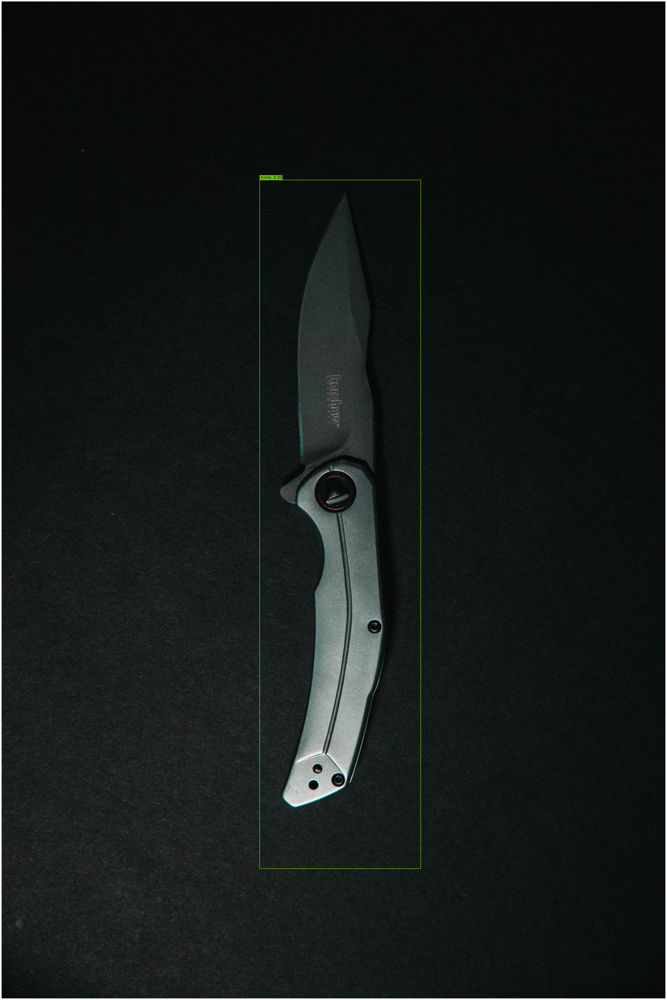

In [14]:
test_image = 'test/images/k002.jpg'
best_model.predict(test_image).show()

## Video

In [10]:
import torch
device = 0 if torch.cuda.is_available() else "cpu"

input_video_path = "test/video/gun.mkv"
output_video_path = "test/out/gun.mkv"
#device=0

best_model.to(device).predict(input_video_path).save(output_video_path)

UnidentifiedImageError: cannot identify image file 'test/video/gun.mkv'

In [15]:
import torch
from super_gradients.training import models
from super_gradients.common.object_names import  Models

models.convert_to_onnx(model = best_model, input_shape = (3,640,640), out_path = "model/onnx/best.onnx")


[2023-08-07 20:39:14] WARNING - conversion.py - input_shape is deprecated and will be removed in the next major release.Use the convert_to_onnx(..., prep_model_for_conversion_kwargs(input_size=(1, 3, 640, 640))) instead


================ Diagnostic Run torch.onnx.export version 2.0.1 ================
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



'model/onnx/best.onnx'